## TODO
- [x] REMGARDER LE SEUIL pour la positivité
- [x] regarder les patients en communs
- [x] regarder Hémoglobine et DFG
- [ ] cleaner le code et mettre sur GitHub
- [ ] Récupérer les figures
- [ ] Commencer à rédiger
- [ ] Finish fine tuning of CODER-EDS. Just execute `/export/home/cse200093/Jacques_Bio/normalisation/py_files/train_coder.sh` file up to 1M iterations (To know the number of iteration, just take a look at where the weigths of CODER-EDS are saved, i.e at `/export/home/cse200093/Jacques_Bio/data_bio/coder_output`. The files are saved with the number of iterations in their names.). Evaluate this model then with the files in `/export/home/cse200093/Jacques_Bio/normalisation/notebooks/coder` for example.

In [28]:
%reload_ext autoreload
%autoreload 2
%reload_ext lab_black
# sc.cancelAllJobs()

In [29]:
import os

os.environ["OMP_NUM_THREADS"] = "16"

In [30]:
from edsteva import improve_performances

spark, sc, sql = improve_performances(
    to_add_conf=[
        ("spark.yarn.max.executor.failures", "10"),
        ("spark.executor.memory", "32g"),
        ("spark.driver.memory", "32g"),
        ("spark.driver.maxResultSize", "16g"),
        ("spark.default.parallelism", 160),
        ("spark.shuffle.service.enabled", "true"),
        ("spark.sql.shuffle.partitions", 160),
        ("spark.yarn.am.memory", "4g"),
        ("spark.yarn.max.executor.failures", 10),
        ("spark.dynamicAllocation.enabled", True),
        ("spark.dynamicAllocation.minExecutors", "20"),
        ("spark.dynamicAllocation.maxExecutors", "20"),
        ("spark.executor.cores", "8"),
    ]
)

In [31]:
import pandas as pd
from os.path import isfile, isdir, join, basename
from os import listdir, mkdir
import spacy
from edsnlp.processing import pipe
import matplotlib.pyplot as plt
import numpy as np
from matplotlib_venn import venn3, venn2
import altair as alt
from functools import reduce

import sys

sys.path.insert(1, "/export/home/cse200093/Jacques_Bio/super_pipe/py_files")
from knowledge import TO_BE_MATCHED

BRAT_DIR = "/export/home/cse200093/Jacques_Bio/data_bio/super_pipe_get_stats_by_section_on_cim10"
RES_DIR = "/export/home/cse200093/Jacques_Bio/data_bio/super_pipe_res/stats_by_section_on_cim10"

# Only execute the following cells if you want to recreate the inference dataset (i.e dataset based on CIM10). PLEASE USE THE ENV `[2.4.3] K8s Py3 client` FOR THIS DATASET CREATION PART !

### Functions

In [5]:
### CELLS TO CREATE THE DATASET CONTAINING ALL TXT FILES WE WANT TO STUDY:
### ALL PATIENTS WITH ONE LINE AT LEAST IN:
# - i2b2_observation_cim10 with correct CIM10 according to `TO_BE_MATCHED`
# - i2b2_observation_doc
# - i2b2_observation_lab (OPTIONAL)

# SHOW DATASETS
sql("USE cse_200093_20210402")
sql("SHOW tables").show(10, False)

# Save txt function
def save_to_txt(path, txt):
    with open(path, "w") as f:
        print(txt, file=f)


def get_docs_df(cim10_list, min_len=1000):
    ### If we filter on `i2b2_observation_lab`
    # docs = sql("""SELECT doc.instance_num, doc.observation_blob, cim10.concept_cd FROM i2b2_observation_doc AS doc
    #               JOIN i2b2_observation_cim10 AS cim10 ON doc.encounter_num = cim10.encounter_num
    #               WHERE ((doc.concept_cd == 'CR:CRH-HOSPI' OR doc.concept_cd == 'CR:CRH-S')
    #               AND EXISTS (SELECT lab.encounter_num FROM i2b2_observation_lab AS lab
    #               WHERE lab.encounter_num = doc.encounter_num))""")

    ### If we don't filter on `i2b2_observation_lab`
    docs = sql(
        """SELECT doc.instance_num, doc.observation_blob, doc.encounter_num, doc.patient_num, visit.age_visit_in_years_num, visit.start_date, cim10.concept_cd FROM i2b2_observation_doc AS doc
                  JOIN i2b2_observation_cim10 AS cim10 ON doc.encounter_num = cim10.encounter_num JOIN i2b2_visit AS visit ON doc.encounter_num = visit.encounter_num
                  WHERE (doc.concept_cd == 'CR:CRH-HOSPI' OR doc.concept_cd == 'CR:CRH-S')
                  """
    )
    ### Filter on cim10_list and export to Pandas
    docs_df = docs.filter(docs.concept_cd.isin(cim10_list)).toPandas().dropna()
    ### Keep documents with some information at least
    docs_df = docs_df.loc[docs_df["observation_blob"].apply(len) > min_len].reset_index(
        drop=True
    )
    docs_df = (
        docs_df.groupby("observation_blob")
        .agg(
            {
                "instance_num": set,
                "encounter_num": "first",
                "patient_num": "first",
                "age_visit_in_years_num": "first",
                "start_date": "first",
                "observation_blob": "first",
            }
        )
        .reset_index(drop=True)
    )
    docs_df["instance_num"] = docs_df["instance_num"].apply(
        lambda instance_num: "_".join(list(instance_num))
    )
    return docs_df


def get_bio_df(summary_docs):

    bio = sql(
        """SELECT bio.instance_num AS bio_id, bio.concept_cd, bio.units_cd, bio.nval_num, bio.tval_char, bio.quantity_num, bio.confidence_num, bio.encounter_num, bio.patient_num, bio.start_date, concept.name_char 
        FROM i2b2_observation_lab AS bio JOIN i2b2_concept AS concept ON bio.concept_cd = concept.concept_cd"""
    )
    bio_dfs = {}
    for disease in summary_docs.disease.unique():
        unique_visit = summary_docs[summary_docs.disease == disease][
            ["encounter_num"]
        ].drop_duplicates()
        unique_visit = spark.createDataFrame(unique_visit).hint("broadcast")
        bio_df = bio.join(unique_visit, on="encounter_num").toPandas()
        bio_df["disease"] = disease
        bio_df["terms_linked_to_measurement"] = bio_df["name_char"].apply(
            _get_term_from_c_name
        )
        bio_df.loc[bio_df["units_cd"].isna(), "units_cd"] = "nounit"
        bio_df = bio_df[~((bio_df.nval_num.isna()) & (bio_df.tval_char.isna()))]
        display(bio_df)
        bio_dfs[disease] = bio_df

    return bio_dfs


def _get_term_from_c_name(c_name):
    return c_name[c_name.index(":") + 1 :].split("_")[0].strip()

+-------------------+-------------------------+-----------+
|database           |tableName                |isTemporary|
+-------------------+-------------------------+-----------+
|cse_200093_20210402|i2b2_concept             |false      |
|cse_200093_20210402|i2b2_observation_ccam    |false      |
|cse_200093_20210402|i2b2_observation_cim10   |false      |
|cse_200093_20210402|i2b2_observation_doc     |false      |
|cse_200093_20210402|i2b2_observation_ghm     |false      |
|cse_200093_20210402|i2b2_observation_lab     |false      |
|cse_200093_20210402|i2b2_observation_med     |false      |
|cse_200093_20210402|i2b2_observation_microbio|false      |
|cse_200093_20210402|i2b2_observation_pacs    |false      |
|cse_200093_20210402|i2b2_observation_physio  |false      |
+-------------------+-------------------------+-----------+
only showing top 10 rows



### Get Docs and Bio

In [6]:
# Get docs and save It for each disease
docs_all_diseases = []
for disease, disease_data in TO_BE_MATCHED.items():
    path_to_brat = join(BRAT_DIR, disease)
    if not os.path.exists(path_to_brat):
        mkdir(path_to_brat)
    docs_df = get_docs_df(["CIM10:" + cim10 for cim10 in disease_data["CIM10"]])
    docs_df.apply(lambda row: save_to_txt(join(path_to_brat, row["instance_num"] + ".txt"), row["observation_blob"]), axis=1)
    print(disease + " processed and saved")
    docs_df["disease"] = disease
    docs_all_diseases.append(docs_df)
summary_df_docs = pd.concat(docs_all_diseases)
summary_df_bio = get_bio_df(summary_df_docs)
summary_df_bio = pd.concat(list(summary_df_bio.values()))
display(summary_df_docs)
display(summary_df_bio)
summary_df_bio.to_pickle(join(BRAT_DIR, "summary_df_bio.pkl"))
summary_df_docs.to_pickle(join(BRAT_DIR, "summary_df_docs.pkl"))

,encounter_num,bio_id,concept_cd,units_cd,nval_num,tval_char,quantity_num,confidence_num,patient_num,start_date,name_char,disease,terms_linked_to_measurement
0,3561665612963255367,-6845789979066478218,LAB:A0232,nounit,NaN,+,NaN,NaN,7891032334776549241,2020-12-04 05:00:00.000000000,A0232 : Poikilocytose Recherche_Sang_Microscop...,lupus_erythemateux_dissemine,Poikilocytose Recherche
1,5847466294848491298,2753442339187735992,LAB:A0232,nounit,NaN,+,NaN,NaN,7165168719450655581,2020-08-13 10:20:00.000000000,A0232 : Poikilocytose Recherche_Sang_Microscop...,lupus_erythemateux_dissemine,Poikilocytose Recherche
2,5847466294848491298,5429501363582213483,LAB:A0232,nounit,NaN,+,NaN,NaN,7165168719450655581,2020-09-25 04:30:00.000000000,A0232 : Poikilocytose Recherche_Sang_Microscop...,lupus_erythemateux_dissemine,Poikilocytose Recherche
3,-223220171225078584,2302960777234397231,LAB:A0232,nounit,NaN,+,NaN,NaN,-7210352331783632876,2020-09-29 13:30:00.000000000,A0232 : Poikilocytose Recherche_Sang_Microscop...,lupus_erythemateux_dissemine,Poikilocytose Recherche
4,-6660143337225047816,-6503937162802689513,LAB:A0232,nounit,NaN,+,NaN,NaN,-7196888725356208115,2021-01-04 07:10:00.000000000,A0232 : Poikilocytose Recherche_Sang_Microscop...,lupus_erythemateux_dissemine,Poikilocytose Recherche
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1396258,1564761434465072926,7949999093335083911,LAB:X8031,nounit,NaN,"Résultat(s) Téléphoné(s):\r\n A, K, CL, PROT...",NaN,NaN,8184255724281820163,2099-07-30 21:43:54.709551616,X8031 : Renseignements Transmission résultat p...,lupus_erythemateux_dissemine,Renseignements Transmission résultat par télép...
1396259,8333892915531547025,7011824418898651557,LAB:X8031,nounit,NaN,Résultat(s) Téléphoné(s):\r\n ...,NaN,NaN,-8619518167900045994,2099-07-30 21:43:54.709551616,X8031 : Renseignements Transmission résultat p...,lupus_erythemateux_dissemine,Renseignements Transmission résultat par télép...
1396260,8539764991810845614,8099330035178621242,LAB:X8031,nounit,NaN,Résultat(s) Téléphoné(s):\r\n ...,NaN,NaN,-7869711971033563562,2099-07-30 21:43:54.709551616,X8031 : Renseignements Transmission résultat p...,lupus_erythemateux_dissemine,Renseignements Transmission résultat par télép...
1396261,2409778390391941641,7831935226315207384,LAB:X8031,nounit,NaN,Résultat(s) Téléphoné(s):\r\n ...,NaN,NaN,4394640331802163926,2099-07-30 21:43:54.709551616,X8031 : Renseignements Transmission résultat p...,lupus_erythemateux_dissemine,Renseignements Transmission résultat par télép...


,encounter_num,bio_id,concept_cd,units_cd,nval_num,tval_char,quantity_num,confidence_num,patient_num,start_date,name_char,disease,terms_linked_to_measurement
0,-223220171225078584,2302960777234397231,LAB:A0232,nounit,NaN,+,NaN,NaN,-7210352331783632876,2020-09-29 13:30:00.000000000,A0232 : Poikilocytose Recherche_Sang_Microscop...,syndrome_des_anti-phospholipides,Poikilocytose Recherche
1,-7921385924020329445,1590270297361905965,LAB:A0232,nounit,NaN,+,NaN,NaN,8073032033567153067,2020-07-13 04:00:00.000000000,A0232 : Poikilocytose Recherche_Sang_Microscop...,syndrome_des_anti-phospholipides,Poikilocytose Recherche
2,-7921385924020329445,-3386285257910080243,LAB:A0232,nounit,NaN,+,NaN,NaN,8073032033567153067,2020-07-13 04:00:00.000000000,A0232 : Poikilocytose Recherche_Sang_Microscop...,syndrome_des_anti-phospholipides,Poikilocytose Recherche
3,-7921385924020329445,7888658037067084908,LAB:A0232,nounit,NaN,++,NaN,NaN,8073032033567153067,2020-07-14 04:00:00.000000000,A0232 : Poikilocytose Recherche_Sang_Microscop...,syndrome_des_anti-phospholipides,Poikilocytose Recherche
4,-7921385924020329445,-6551566272114446262,LAB:A0232,nounit,NaN,+,NaN,NaN,8073032033567153067,2020-07-15 04:00:00.000000000,A0232 : Poikilocytose Recherche_Sang_Microscop...,syndrome_des_anti-phospholipides,Poikilocytose Recherche
...,...,...,...,...,...,...,...,...,...,...,...,...,...
462631,8947311847966923863,8161773783300647609,LAB:X2599,nounit,NaN,Absence de coagulum.,NaN,NaN,-8712920484216340424,2021-03-16 04:30:00.000000000,X2599 : Commentaire Hémostase_Sang (Unités : i...,syndrome_des_anti-phospholipides,Commentaire Hémostase
462632,2977450181633041335,-7927838666253698232,LAB:X6345,nounit,NaN,Possibles augmentations non spécifiques en ca...,NaN,NaN,6491990896932380142,2020-05-22 07:40:00.000000000,X6345 : Chromogranine A Commentaire_Sérum (Uni...,syndrome_des_anti-phospholipides,Chromogranine A Commentaire
462633,5918069989667546569,2352285272226085722,LAB:X6345,nounit,NaN,Possibles augmentations non spécifiques en ca...,NaN,NaN,-6432492644978204716,2020-04-02 06:00:00.000000000,X6345 : Chromogranine A Commentaire_Sérum (Uni...,syndrome_des_anti-phospholipides,Chromogranine A Commentaire
462634,-2098768982488349839,-8680075008809401720,LAB:X8031,nounit,NaN,"Résultat(s) Téléphoné(s):\r\n on MPA 1, Anal...",NaN,NaN,-6176962492388497566,2099-07-30 21:43:54.709551616,X8031 : Renseignements Transmission résultat p...,syndrome_des_anti-phospholipides,Renseignements Transmission résultat par télép...


,encounter_num,bio_id,concept_cd,units_cd,nval_num,tval_char,quantity_num,confidence_num,patient_num,start_date,name_char,disease,terms_linked_to_measurement
0,-4311560396992024605,6000958407855368789,LAB:A0232,nounit,NaN,+,NaN,NaN,-4577119031679877315,2020-06-27 10:30:00.000000000,A0232 : Poikilocytose Recherche_Sang_Microscop...,sclerodermie_systemique,Poikilocytose Recherche
1,5172728569519111234,6522620232041128072,LAB:A0232,nounit,NaN,+,NaN,NaN,-7583968836989874063,2020-07-23 06:50:00.000000000,A0232 : Poikilocytose Recherche_Sang_Microscop...,sclerodermie_systemique,Poikilocytose Recherche
2,-6219608678008208685,6555269140775663182,LAB:A0232,nounit,NaN,++,NaN,NaN,8506920460504332005,2020-11-17 07:35:00.000000000,A0232 : Poikilocytose Recherche_Sang_Microscop...,sclerodermie_systemique,Poikilocytose Recherche
3,-6219608678008208685,3005660997956486417,LAB:A0232,nounit,NaN,++,NaN,NaN,8506920460504332005,2020-11-29 17:33:00.000000000,A0232 : Poikilocytose Recherche_Sang_Microscop...,sclerodermie_systemique,Poikilocytose Recherche
4,-6219608678008208685,-8556668372520630206,LAB:A0232,nounit,NaN,++,NaN,NaN,8506920460504332005,2020-12-03 05:00:00.000000000,A0232 : Poikilocytose Recherche_Sang_Microscop...,sclerodermie_systemique,Poikilocytose Recherche
...,...,...,...,...,...,...,...,...,...,...,...,...,...
771194,-4148901067355379475,8786264961590226413,LAB:X8031,nounit,NaN,"Résultat(s) Téléphoné(s):\r\n P ALC, ASP Ap ...",NaN,NaN,-4276702265798357835,2099-07-30 21:43:54.709551616,X8031 : Renseignements Transmission résultat p...,sclerodermie_systemique,Renseignements Transmission résultat par télép...
771195,1941412931244146152,458225887023722499,LAB:X8031,nounit,NaN,Résultat(s) Téléphoné(s):\r\n ...,NaN,NaN,1859200897116175963,2099-07-30 21:43:54.709551616,X8031 : Renseignements Transmission résultat p...,sclerodermie_systemique,Renseignements Transmission résultat par télép...
771196,8539764991810845614,8099330035178621242,LAB:X8031,nounit,NaN,Résultat(s) Téléphoné(s):\r\n ...,NaN,NaN,-7869711971033563562,2099-07-30 21:43:54.709551616,X8031 : Renseignements Transmission résultat p...,sclerodermie_systemique,Renseignements Transmission résultat par télép...
771197,39425808205743794,-7934503391612459240,LAB:X8031,nounit,NaN,Résultat(s) Téléphoné(s):\r\n Exam...,NaN,NaN,2876575040170712431,2099-07-30 21:43:54.709551616,X8031 : Renseignements Transmission résultat p...,sclerodermie_systemique,Renseignements Transmission résultat par télép...


,encounter_num,bio_id,concept_cd,units_cd,nval_num,tval_char,quantity_num,confidence_num,patient_num,start_date,name_char,disease,terms_linked_to_measurement
0,-2675587359833823674,7410439950986074988,LAB:A0232,nounit,NaN,+,NaN,NaN,-4928547947345347396,2020-10-01 03:20:00,A0232 : Poikilocytose Recherche_Sang_Microscop...,maladie_de_takayasu,Poikilocytose Recherche
1,5172728569519111234,6522620232041128072,LAB:A0232,nounit,NaN,+,NaN,NaN,-7583968836989874063,2020-07-23 06:50:00,A0232 : Poikilocytose Recherche_Sang_Microscop...,maladie_de_takayasu,Poikilocytose Recherche
2,-7885777867322885824,-5219835282749712368,LAB:A1109,µmol/l,50.0,E,50.0,90.0,-2825933499379815380,2020-03-02 10:50:00,A1109 : Transferrine Capacité de fixation du f...,maladie_de_takayasu,Transferrine Capacité de fixation du fer
3,-7814130145703354906,5821725036324921414,LAB:A1109,µmol/l,60.0,E,50.0,90.0,-7253923095553364608,2020-11-09 09:40:00,A1109 : Transferrine Capacité de fixation du f...,maladie_de_takayasu,Transferrine Capacité de fixation du fer
4,6983946757228466376,-1440247738891952456,LAB:A1109,µmol/l,52.0,E,50.0,90.0,-2825933499379815380,2020-10-06 13:45:00,A1109 : Transferrine Capacité de fixation du f...,maladie_de_takayasu,Transferrine Capacité de fixation du fer
...,...,...,...,...,...,...,...,...,...,...,...,...,...
64176,1207595980582004175,841469051538676015,LAB:H6272,UGPL,1.6,L,NaN,20.0,-3188750471599363916,2019-12-09 12:00:00,H6272 : Cardiolipine anticorps IgG Titre_Sérum...,maladie_de_takayasu,Cardiolipine anticorps IgG Titre
64177,-9156559221162932789,6752580133035392495,LAB:H6272,UGPL,1.6,L,NaN,20.0,-6819420394932943886,2015-07-21 03:45:00,H6272 : Cardiolipine anticorps IgG Titre_Sérum...,maladie_de_takayasu,Cardiolipine anticorps IgG Titre
64178,2458167616405962814,6118373007544243584,LAB:H6272,UGPL,1.6,L,NaN,20.0,5867235337080661065,2020-03-11 08:55:00,H6272 : Cardiolipine anticorps IgG Titre_Sérum...,maladie_de_takayasu,Cardiolipine anticorps IgG Titre
64179,-586744787622334875,6234141349777825135,LAB:X6345,nounit,NaN,Possibles augmentations non spécifiques en ca...,NaN,NaN,3183367260525214651,2020-06-30 13:45:00,X6345 : Chromogranine A Commentaire_Sérum (Uni...,maladie_de_takayasu,Chromogranine A Commentaire


,instance_num,encounter_num,patient_num,age_visit_in_years_num,start_date,observation_blob,disease
0,2738793396443569263,3803839342475884448,5317029792719207815,61.0,2017-02-22 07:14:00,\t\nru;e ut:b rd !.E1UIUI iveu Rdes \nDEPARTEM...,lupus_erythemateux_dissemine
1,2615820988916910818,4992839136510813267,2831612793302182025,32.0,2017-04-14 20:44:00,\nGROUPE HOSPITALIER\nPITIE-SALPETRIERE\nCHARL...,lupus_erythemateux_dissemine
2,272958080818376284,3276465157723298984,-3572739121544720381,59.0,2017-02-28 15:22:00,\nGROUPE HOSPITALIER\nPITIE-SALPETRIERE\nCHARL...,lupus_erythemateux_dissemine
3,-5749954592132123975,1363081583091187160,-1973278162184058890,45.0,2017-03-09 14:36:00,\nGROUPE HOSPITALIER\nPITIE-SALPETRIERE\nCHARL...,lupus_erythemateux_dissemine
4,-5536853461360679914,-1576052356032903687,231344257804909702,70.0,2017-05-16 16:39:00,\nGROUPE HOSPITALIER\nPITIE-SALPETRIERE\nCHARL...,lupus_erythemateux_dissemine
...,...,...,...,...,...,...,...
960,1500282541334952594,2271753531377468697,8978163519485748821,39.0,2019-06-12 17:53:00,ital Monsieur ANN LYSE CUPIT\nRU DU FBG SAINT ...,maladie_de_takayasu
961,-3687052808872203220,-5641166715641200394,-3927378917359334611,86.0,2017-05-23 15:18:00,sifs de Cardiologie : 0671930300\nsifs de Card...,maladie_de_takayasu
962,1025776390073548131,7610531353325907119,2732126380953225026,42.0,2016-06-20 13:34:00,sifs de Cardiologie : 07.53.16.65.67\nsifs de ...,maladie_de_takayasu
963,-6258076113183662585,6027391545714128064,-690007508873253361,41.0,2019-09-20 15:16:00,v5.2\nkg\n%\nCystatine C :\nFréq. Card. (/mn) ...,maladie_de_takayasu


,encounter_num,bio_id,concept_cd,units_cd,nval_num,tval_char,quantity_num,confidence_num,patient_num,start_date,name_char,disease,terms_linked_to_measurement
0,3561665612963255367,-6845789979066478218,LAB:A0232,nounit,NaN,+,NaN,NaN,7891032334776549241,2020-12-04 05:00:00,A0232 : Poikilocytose Recherche_Sang_Microscop...,lupus_erythemateux_dissemine,Poikilocytose Recherche
1,5847466294848491298,2753442339187735992,LAB:A0232,nounit,NaN,+,NaN,NaN,7165168719450655581,2020-08-13 10:20:00,A0232 : Poikilocytose Recherche_Sang_Microscop...,lupus_erythemateux_dissemine,Poikilocytose Recherche
2,5847466294848491298,5429501363582213483,LAB:A0232,nounit,NaN,+,NaN,NaN,7165168719450655581,2020-09-25 04:30:00,A0232 : Poikilocytose Recherche_Sang_Microscop...,lupus_erythemateux_dissemine,Poikilocytose Recherche
3,-223220171225078584,2302960777234397231,LAB:A0232,nounit,NaN,+,NaN,NaN,-7210352331783632876,2020-09-29 13:30:00,A0232 : Poikilocytose Recherche_Sang_Microscop...,lupus_erythemateux_dissemine,Poikilocytose Recherche
4,-6660143337225047816,-6503937162802689513,LAB:A0232,nounit,NaN,+,NaN,NaN,-7196888725356208115,2021-01-04 07:10:00,A0232 : Poikilocytose Recherche_Sang_Microscop...,lupus_erythemateux_dissemine,Poikilocytose Recherche
...,...,...,...,...,...,...,...,...,...,...,...,...,...
64176,1207595980582004175,841469051538676015,LAB:H6272,UGPL,1.6,L,NaN,20.0,-3188750471599363916,2019-12-09 12:00:00,H6272 : Cardiolipine anticorps IgG Titre_Sérum...,maladie_de_takayasu,Cardiolipine anticorps IgG Titre
64177,-9156559221162932789,6752580133035392495,LAB:H6272,UGPL,1.6,L,NaN,20.0,-6819420394932943886,2015-07-21 03:45:00,H6272 : Cardiolipine anticorps IgG Titre_Sérum...,maladie_de_takayasu,Cardiolipine anticorps IgG Titre
64178,2458167616405962814,6118373007544243584,LAB:H6272,UGPL,1.6,L,NaN,20.0,5867235337080661065,2020-03-11 08:55:00,H6272 : Cardiolipine anticorps IgG Titre_Sérum...,maladie_de_takayasu,Cardiolipine anticorps IgG Titre
64179,-586744787622334875,6234141349777825135,LAB:X6345,nounit,NaN,Possibles augmentations non spécifiques en ca...,NaN,NaN,3183367260525214651,2020-06-30 13:45:00,X6345 : Chromogranine A Commentaire_Sérum (Uni...,maladie_de_takayasu,Chromogranine A Commentaire


In [ ]:
summary_df_bio["found"] = summary_df_bio["nval_num"].mask(
    summary_df_bio["nval_num"].isna(), summary_df_bio["tval_char"]
)
summary_df_bio["gold"] = (
    summary_df_bio["found"].astype(str) + " " + summary_df_bio["units_cd"]
)
summary_df_bio = summary_df_bio.groupby(
    ["disease", "encounter_num", "patient_num", "terms_linked_to_measurement"], as_index=False
).agg({"name_char": list, "gold": list})
summary_df_bio.to_json(join(BRAT_DIR, "summary_df_bio.json"))

# Summary description of the data

In [70]:
import altair as alt

summary_df_docs = pd.read_pickle(join(BRAT_DIR, "summary_df_docs.pkl"))
summary_df_bio = pd.read_pickle(join(BRAT_DIR, "summary_df_bio.pkl"))

## Number of docs/visit/patients

In [5]:
summary_df_docs.groupby("disease").agg(
    {"instance_num": "nunique", "encounter_num": "nunique", "patient_num": "nunique"}
)

,instance_num,encounter_num,patient_num
disease,,,
lupus_erythemateux_dissemine,10764,8932,3437
maladie_de_takayasu,965,833,252
sclerodermie_systemique,7585,6455,2031
syndrome_des_anti-phospholipides,2380,1818,1059


## Number of Bio/visit/patient

In [11]:
summary_df_bio.groupby("disease").agg(
    {"bio_id": "nunique", "encounter_num": "nunique", "patient_num": "nunique"}
)

,bio_id,encounter_num,patient_num
disease,,,
lupus_erythemateux_dissemine,1375193,5829,2593
maladie_de_takayasu,63282,431,190
sclerodermie_systemique,762480,4450,1604
syndrome_des_anti-phospholipides,455144,1346,863


## Age histogram

In [78]:
summary_df_docs["round_age"] = (summary_df_docs["age_visit_in_years_num"] * 2).round(
    -1
) / 2
age_summary = summary_df_docs.groupby(
    ["disease", "age_visit_in_years_num"], as_index=False
).agg({"patient_num": "nunique"})
round_age_summary = summary_df_docs.groupby(
    ["disease", "round_age"], as_index=False
).agg({"patient_num": "nunique"})
total_patient = (
    summary_df_docs.groupby("disease", as_index=False)
    .agg({"patient_num": "nunique"})
    .rename(columns={"patient_num": "total_patient"})
)
age_summary = age_summary.merge(total_patient, on="disease")
age_summary["density"] = age_summary["patient_num"] / age_summary["total_patient"]
display(age_summary)

,disease,age_visit_in_years_num,patient_num,total_patient,density
0,lupus_erythemateux_dissemine,11.0,1,3437,0.000291
1,lupus_erythemateux_dissemine,12.0,4,3437,0.001164
2,lupus_erythemateux_dissemine,13.0,2,3437,0.000582
3,lupus_erythemateux_dissemine,14.0,8,3437,0.002328
4,lupus_erythemateux_dissemine,15.0,21,3437,0.006110
...,...,...,...,...,...
312,syndrome_des_anti-phospholipides,88.0,5,1059,0.004721
313,syndrome_des_anti-phospholipides,89.0,5,1059,0.004721
314,syndrome_des_anti-phospholipides,90.0,2,1059,0.001889
315,syndrome_des_anti-phospholipides,93.0,1,1059,0.000944


In [99]:
alt.data_transformers.disable_max_rows()

alt.Chart(round_age_summary).mark_bar(size=12, align="left").encode(
    alt.X("round_age:Q").title("Age at stay"),
    alt.Y("patient_num:Q").title("Number of patients"),
    alt.Row("disease:N"),
).resolve_scale(y="independent").properties(height=200)

alt.Chart(...)

In [96]:
alt.data_transformers.disable_max_rows()

alt.Chart(round_age_summary).mark_area(interpolate="step-after").encode(
    alt.X("round_age:Q").title("Age at stay"),
    alt.Y("patient_num:Q").title("Number of patients"),
    alt.Row("disease:N"),
).resolve_scale(y="independent").properties(height=200)

alt.Chart(...)

In [62]:
alt.data_transformers.disable_max_rows()

alt.Chart(age_summary).mark_area().encode(
    alt.X("age_visit_in_years_num:Q").title("Age at stay"),
    alt.Y("patient_num:Q").title("Number of patients"),
    alt.Row("disease:N"),
).resolve_scale(y="independent").properties(height=200)

alt.Chart(...)

In [39]:
alt.data_transformers.disable_max_rows()

alt.Chart(age_summary).mark_area(interpolate="basis").encode(
    alt.X("age_visit_in_years_num:Q").title("Age at stay"),
    alt.Y("density:Q").title("Density"),
    alt.Row("disease:N"),
).properties(height=200)

alt.Chart(...)

In [24]:
alt.data_transformers.disable_max_rows()

alt.Chart(age_summary).mark_bar().encode(
    alt.X("age_visit_in_years_num:Q"),
    alt.Y("density:Q"),
    alt.Row("disease:N"),
    color="disease:N",
).properties(height=200)

alt.Chart(...)

In [22]:
alt.data_transformers.disable_max_rows()

alt.Chart(age_summary).mark_area(opacity=0.4).encode(
    alt.X("age_visit_in_years_num:Q"), alt.Y("density:Q").stack(None), color="disease:N"
).properties(height=200)

alt.Chart(...)

In [29]:
alt.data_transformers.disable_max_rows()

alt.Chart(age_summary).mark_area().encode(
    alt.X("age_visit_in_years_num:Q"),
    alt.Y("density:Q").stack(True),
    color="disease:N",
).properties(height=200)

alt.Chart(...)

## Stay start histogramm

In [109]:
summary_df_docs["month_date"] = (
    summary_df_docs["start_date"].dt.strftime("%Y-%m").astype("datetime64[ns]")
)
month_date_summary = summary_df_docs.groupby(
    ["disease", "month_date"], as_index=False
).agg({"encounter_num": "nunique"})
total_visit = (
    summary_df_docs.groupby("disease", as_index=False)
    .agg({"encounter_num": "nunique"})
    .rename(columns={"encounter_num": "total_visit"})
)
month_date_summary = month_date_summary.merge(total_visit, on="disease")
month_date_summary["density"] = (
    month_date_summary["encounter_num"] / month_date_summary["total_visit"]
)
display(month_date_summary)

,disease,month_date,encounter_num,total_visit,density
0,lupus_erythemateux_dissemine,2011-11-01,1,8932,0.000112
1,lupus_erythemateux_dissemine,2011-12-01,1,8932,0.000112
2,lupus_erythemateux_dissemine,2012-03-01,1,8932,0.000112
3,lupus_erythemateux_dissemine,2012-06-01,1,8932,0.000112
4,lupus_erythemateux_dissemine,2012-10-01,1,8932,0.000112
...,...,...,...,...,...
370,syndrome_des_anti-phospholipides,2020-11-01,39,1818,0.021452
371,syndrome_des_anti-phospholipides,2020-12-01,31,1818,0.017052
372,syndrome_des_anti-phospholipides,2021-01-01,28,1818,0.015402
373,syndrome_des_anti-phospholipides,2021-02-01,32,1818,0.017602


In [117]:
alt.data_transformers.disable_max_rows()
alt.Chart(month_date_summary).mark_bar(align="left").encode(
    alt.X("yearquarter(month_date):T")
    .title("Time (Year)")
    .axis(tickCount="year", labelAngle=0, grid=True, format="%Y"),
    alt.Y("sum(encounter_num):Q").title("Number of stays"),
    alt.Row("disease:N"),
).resolve_scale(y="independent").properties(height=200, width=600)

alt.Chart(...)

In [118]:
alt.data_transformers.disable_max_rows()

alt.Chart(start_date_summary).mark_area(interpolate="basis").encode(
    alt.X("month_date:T").title("Time (Year)"),
    alt.Y("density:Q").title("Density"),
    alt.Row("disease:N"),
).properties(height=200, width=600)

alt.Chart(...)

In [50]:
alt.data_transformers.disable_max_rows()

alt.Chart(start_date_summary).mark_bar().encode(
    alt.X("month_date:T").title("Time (Year)"),
    alt.Y("density:Q").title("Density"),
    alt.Row("disease:N"),
    color="disease:N",
).properties(height=200)

alt.Chart(...)

In [120]:
alt.data_transformers.disable_max_rows()

alt.Chart(start_date_summary).mark_area(opacity=0.4).encode(
    alt.X("month_date:T"), alt.Y("density:Q").stack(None), color="disease:N"
).properties(height=200, width=600)

alt.Chart(...)

In [53]:
alt.data_transformers.disable_max_rows()

alt.Chart(start_date_summary).mark_area().encode(
    alt.X("month_date:T"),
    alt.Y("density:Q").stack(True),
    color="disease:N",
).properties(height=200)

alt.Chart(...)

# Please infer super_pipe on `BRAT_DIR` subfolders. Use the sbatch file in `/export/home/cse200093/Jacques_Bio/super_pipe/py_files/sbatch/main.sh`. res path should be in `RES_DIR`. NOW, PLEASE USE `jacques-spark` FOR THE NEXT CELLS.

In [8]:
summary_df_bio = pd.read_pickle(join(BRAT_DIR, "summary_df_bio.pkl"))
codes_to_keep = {"disease": [], "concept_cd": [], "bio": []}
for disease, disease_data in TO_BE_MATCHED.items():
    for label, code_list in disease_data["ANABIO_codes"].items():
        for code in code_list:
            codes_to_keep["disease"].append(disease)
            codes_to_keep["concept_cd"].append(f"LAB:{code}")
            codes_to_keep["bio"].append(label)
summary_filtered_res = summary_df_bio.merge(
    pd.DataFrame(codes_to_keep), on=["disease", "concept_cd"]
)
for disease in TO_BE_MATCHED.keys():
    summary_filtered_res[summary_filtered_res.disease == disease].to_pickle(
        join(RES_DIR, disease, "summary_filtered_res.pkl")
    )
display(summary_filtered_res)
summary_filtered_res.to_pickle(join(RES_DIR, "summary_filtered_res.pkl"))

,encounter_num,bio_id,concept_cd,units_cd,nval_num,tval_char,quantity_num,confidence_num,patient_num,start_date,name_char,disease,terms_linked_to_measurement,bio
0,4565980477186177850,-1327774826301794317,LAB:B1945,g/dL,10.7,E,12.0,16.0,4149146606120910268,2020-09-29 13:40:00.000000000,B1945 : Hémoglobine Gaz du sang_Sang artériel_...,lupus_erythemateux_dissemine,Hémoglobine Gaz du sang,Hémoglobine
1,4565980477186177850,-1903987201395379157,LAB:B1945,g/dL,10.2,E,12.0,16.0,4149146606120910268,2020-09-30 05:50:57.000000000,B1945 : Hémoglobine Gaz du sang_Sang artériel_...,lupus_erythemateux_dissemine,Hémoglobine Gaz du sang,Hémoglobine
2,4565980477186177850,-6683811631103160972,LAB:B1945,g/dL,12.2,E,12.0,16.0,4149146606120910268,2020-10-01 14:18:38.000000000,B1945 : Hémoglobine Gaz du sang_Sang artériel_...,lupus_erythemateux_dissemine,Hémoglobine Gaz du sang,Hémoglobine
3,-7901439971872834220,-1659885350808809020,LAB:B1945,g/dL,11.3,E,12.0,15.0,-970351602941173040,2020-03-02 13:11:00.000000000,B1945 : Hémoglobine Gaz du sang_Sang artériel_...,lupus_erythemateux_dissemine,Hémoglobine Gaz du sang,Hémoglobine
4,2074303759928599166,4040799449829808629,LAB:B1945,g/dL,11.4,E,13.5,17.5,-7797534100687428397,2099-07-30 21:43:54.709551616,B1945 : Hémoglobine Gaz du sang_Sang artériel_...,lupus_erythemateux_dissemine,Hémoglobine Gaz du sang,Hémoglobine
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
172133,6404901213017377936,2602722918713548026,LAB:A0094,µmol/L,82.0,E,40.0,120.0,5830359601606805541,2018-03-26 06:40:00.000000000,A0094 : Créatinine_Sérum/Plasma_µmol/L (Unités...,maladie_de_takayasu,Créatinine,Créatininémie
172134,3477631712002186949,-6154854342497025597,LAB:A0094,µmol/L,356.0,E,44.0,98.0,-1365483000247647729,2019-04-09 13:25:00.000000000,A0094 : Créatinine_Sérum/Plasma_µmol/L (Unités...,maladie_de_takayasu,Créatinine,Créatininémie
172135,3477631712002186949,775575233181317989,LAB:A0094,µmol/L,283.0,E,44.0,98.0,-1365483000247647729,2019-04-06 06:10:00.000000000,A0094 : Créatinine_Sérum/Plasma_µmol/L (Unités...,maladie_de_takayasu,Créatinine,Créatininémie
172136,3477631712002186949,1302232516747402172,LAB:A0094,µmol/L,345.0,E,44.0,98.0,-1365483000247647729,2019-04-04 06:10:00.000000000,A0094 : Créatinine_Sérum/Plasma_µmol/L (Unités...,maladie_de_takayasu,Créatinine,Créatininémie


In [33]:
structured_res = pd.read_json(
    join(BRAT_DIR, "summary_df_bio.json"),
    dtype={"encounter_num": str, "patient_num": str},
).explode("label")
cuis_to_keep = {"disease": [], "label": [], "bio": []}
for disease, disease_data in TO_BE_MATCHED.items():
    for cui_dic in disease_data["CUI_per_section"].values():
        for cui_label, cui_list in cui_dic.items():
            for cui in cui_list:
                cuis_to_keep["disease"].append(disease)
                cuis_to_keep["label"].append(cui)
                cuis_to_keep["bio"].append(cui_label)
structured_filtered_res = structured_res.merge(
    pd.DataFrame(cuis_to_keep), on=["disease", "label"]
)
for disease in TO_BE_MATCHED.keys():
    structured_filtered_res[structured_filtered_res.disease == disease].to_pickle(
        join(RES_DIR, disease, "structured_filtered_res.pkl")
    )
display(structured_filtered_res)
structured_filtered_res.to_pickle(join(RES_DIR, "structured_filtered_res.pkl"))

,disease,terms_linked_to_measurement,name_char,gold,label,des,encounter_num,patient_num,bio
0,lupus_erythemateux_dissemine,Créatinine,[A0094 : Créatinine_Sérum/Plasma_µmol/L (Unité...,"[59.0 µmol/L, Non calc mmol/24H, 23.12 mmol/L]",C0201975,CREATININE,-1003096193368992544,7706753715636037721,Créatininémie
1,lupus_erythemateux_dissemine,Créatinine,[A7813 : Créatinine_Sérum/Plasma_Méthode enzym...,"[51.0 µmol/l, 15.55 mmol/l]",C0201975,CREATININE,-1003672571907857323,-8774443117876179141,Créatininémie
2,lupus_erythemateux_dissemine,Créatinine,[A0094 : Créatinine_Sérum/Plasma_µmol/L (Unité...,"[123.0 µmol/L, 125.0 µmol/L, 123.0 µmol/L, 115...",C0201975,CREATININE,-1007338985624860187,-3598750537006497849,Créatininémie
3,lupus_erythemateux_dissemine,Créatinine,[A7813 : Créatinine_Sérum/Plasma_Méthode enzym...,"[54.0 µmol/L, 41.0 µmol/L, 38.0 µmol/L]",C0201975,CREATININE,-1007981841955736956,8504471614187815299,Créatininémie
4,lupus_erythemateux_dissemine,Créatinine,[A0094 : Créatinine_Sérum/Plasma_µmol/L (Unité...,"[94.0 µmol/l, 5.8 mmol/l]",C0201975,CREATININE,-1008792500665533887,-3419374364805565429,Créatininémie
...,...,...,...,...,...,...,...,...,...
34289,syndrome_des_anti-phospholipides,Amphiphysine anticorps Recherche,[E6357 : Amphiphysine anticorps Recherche_Séru...,"[Négative 0, Négative 0]",C0201534,APLAB,-6526032664387162714,8196933122041667800,Anti_phospholipides
34290,syndrome_des_anti-phospholipides,Phospholipides anticorps Interprétation,[C4781 : Phospholipides anticorps Interprétati...,[Négative 0],C0201534,Anticorps antiphospholipides,-7942442514199168266,-7317537567538518400,Anti_phospholipides
34291,syndrome_des_anti-phospholipides,Amphiphysine anticorps Recherche,[F6068 : Amphiphysine anticorps Recherche_Séru...,[Négatif 0],C0201534,APLAB,3916329252014208816,744566747945193717,Anti_phospholipides
34292,syndrome_des_anti-phospholipides,Phospholipides anticorps Interprétation,[C4781 : Phospholipides anticorps Interprétati...,[Faiblement positif 0],C0201534,Anticorps antiphospholipides,5027612934969340373,-8319182352790614036,Anti_phospholipides


In [4]:
# Load nlp pipe to detect sections
nlp_sections = spacy.blank("eds")
nlp_sections.add_pipe("eds.normalizer")
nlp_sections.add_pipe("eds.sections")

# Check if two spans are overlapping for section detection
def is_overlapping(a, b):
    # Return true if a segment is overlapping b
    # else False
    return min(a[1], b[1]) > max(a[0], b[0])


# Check if we have to keep a match or not based on section and CUI
def keep_match(cui, span, txt_section_part_df, cui_per_section, cuis_to_keep):
    if cui not in cuis_to_keep:
        return None
    for section in cui_per_section.keys():
        if section == "all":
            for bio, cui_list in cui_per_section["all"].items():
                if cui in cui_list:
                    return bio
        elif section not in txt_section_part_df["label"].tolist():
            continue
        else:
            section_spans = (
                txt_section_part_df.loc[txt_section_part_df["label"] == section]
                .apply(lambda row: [row["start"], row["end"]], axis=1)
                .tolist()
            )
            for section_span in section_spans:
                if is_overlapping(span, section_span):
                    for bio, cui_list in cui_per_section[section].items():
                        if cui in cui_list:
                            return bio
            else:
                continue
    return None


# List of df by disease for concatenation
res_part_filtered_list = []
txt_sections_part_df_list = []
res_part_df_list = []
for disease, disease_data in TO_BE_MATCHED.items():
    ### Load each res dataset to concat them in one unique df
    res_part_df = pd.read_json(join(RES_DIR, disease, "res.json"))
    res_part_df["disease"] = disease

    ### Load txt files, detect sections and store it in df
    # Load txt files in DataFrame
    txt_files_part = [
        f
        for f in listdir(join(BRAT_DIR, "pred", disease + "_pred"))
        if isfile(join(BRAT_DIR, "pred", disease + "_pred", f))
        if f.endswith(".txt")
    ]
    txt_list_part = []
    for txt_file in txt_files_part:
        with open(join(BRAT_DIR, "pred", disease + "_pred", txt_file), "r") as file:
            text = file.read()
            txt_list_part.append([text, txt_file[:-3] + "ann"])
    txt_sections_part_df = pd.DataFrame(txt_list_part, columns=["note_text", "note_id"])

    # Infer nlp pipe to detect sections
    txt_sections_part_df = pipe(
        note=txt_sections_part_df,
        nlp=nlp_sections,
        n_jobs=-2,
        additional_spans=["sections"],
    ).drop(columns=["span_type", "lexical_variant"])
    txt_sections_part_df["disease"] = disease

    ### Filter CUIS to keep
    sections_to_keep = list(disease_data["CUI_per_section"].keys())
    cuis_to_keep = [
        cui
        for cui_dic in disease_data["CUI_per_section"].values()
        for cui_list in cui_dic.values()
        for cui in cui_list
    ]
    res_part_filtered = []

    for source in res_part_df["source"].unique():
        txt_sections_part_source_df = txt_sections_part_df.loc[
            (txt_sections_part_df["note_id"] == source)
            & (txt_sections_part_df["label"].isin(sections_to_keep))
        ]
        for _, row in res_part_df.loc[res_part_df["source"] == source].iterrows():
            for cui in row["label"]:
                to_keep = keep_match(
                    cui,
                    row["span_converted"],
                    txt_sections_part_source_df,
                    disease_data["CUI_per_section"],
                    cuis_to_keep,
                )
                if to_keep:
                    row["bio"] = to_keep
                    res_part_filtered.append(row)
                    break

    ### Save for future concatenation
    res_part_df.to_pickle(join(RES_DIR, disease, "res_final.pkl"))
    res_part_df_list.append(res_part_df)
    pd.DataFrame(res_part_filtered).to_pickle(
        join(RES_DIR, disease, "res_final_filtered.pkl")
    )
    res_part_filtered_list += res_part_filtered
    txt_sections_part_df.to_pickle(join(RES_DIR, disease, "txt_sections_df.pkl"))
    txt_sections_part_df_list.append(txt_sections_part_df)

res_df = pd.concat(res_part_df_list)
res_filtered_df = pd.DataFrame(res_part_filtered_list)
txt_sections_df = pd.concat(txt_sections_part_df_list)
txt_sections_df.to_pickle(join(RES_DIR, "txt_sections_df.pkl"))
res_df.to_pickle(join(RES_DIR, "res_final.pkl"))
res_filtered_df.to_pickle(join(RES_DIR, "res_final_filtered.pkl"))
display(res_df)
display(res_filtered_df)

2023-09-11 16:11:15.010 | WARNING  | edsnlp.pipelines.misc.sections.sections:__init__:72 - The component Sections is still in Beta. Use at your own risks.
[Parallel(n_jobs=-2)]: Using backend MultiprocessingBackend with 4 concurrent workers.
[Parallel(n_jobs=-2)]: Done   5 tasks      | elapsed:    9.0s
[Parallel(n_jobs=-2)]: Done  10 tasks      | elapsed:   13.6s
[Parallel(n_jobs=-2)]: Done  17 tasks      | elapsed:   22.0s
[Parallel(n_jobs=-2)]: Done  24 tasks      | elapsed:   28.1s
[Parallel(n_jobs=-2)]: Done  33 tasks      | elapsed:   39.5s
[Parallel(n_jobs=-2)]: Done  42 tasks      | elapsed:   48.3s
[Parallel(n_jobs=-2)]: Done  53 tasks      | elapsed:  1.0min
[Parallel(n_jobs=-2)]: Done  64 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-2)]: Done  77 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-2)]: Done  90 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-2)]: Done 108 out of 108 | elapsed:  2.0min finished
[Parallel(n_jobs=-2)]: Using backend MultiprocessingBackend with 4 

,term,source,span_converted,found,terms_linked_to_measurement,label,des,disease
0,test de Coombs positif,-3001170674403048468.ann,"[2379, 2401]",[= 1.0 bool],test de Coombs,[C0009961],coombs testing,lupus_erythemateux_dissemine
1,créatininémie 199 umol/l,-3001170674403048468.ann,"[2647, 2671]",[= 199.0 nounit],créatininémie,[C0201975],Creatinine sanguine,lupus_erythemateux_dissemine
2,albumine 33 g/l,-3001170674403048468.ann,"[2673, 2688]",[= 33.0 g_per_l],albumine,[C0201838],Albumine,lupus_erythemateux_dissemine
3,créatininémie 624 umol/l,-3001170674403048468.ann,"[3502, 3526]",[= 624.0 nounit],créatininémie,[C0201975],Creatinine sanguine,lupus_erythemateux_dissemine
4,albuminémie 15 g/l,-3001170674403048468.ann,"[3527, 3545]",[= 15.0 g_per_l],albuminémie,[C0042038],Albumine urinaire,lupus_erythemateux_dissemine
...,...,...,...,...,...,...,...,...
37555,sérologie Brucellose négative,-1573419676043752292.ann,"[5392, 5421]",[= 0.0 bool],sérologie Brucellose,[C0523269],Serologie Brucella,maladie_de_takayasu
37556,sérologie Rickettsiose négative,-1573419676043752292.ann,"[5423, 5454]",[= 0.0 bool],sérologie Rickettsiose,[C0201316],Rickettsial serologic study NOS,maladie_de_takayasu
37557,sérologie Borréliose négative,-1573419676043752292.ann,"[5456, 5485]",[= 0.0 bool],sérologie Borréliose,[C0523266],Serologic Borrelia NOS,maladie_de_takayasu
37558,CRP à 98 mg/l,-1573419676043752292.ann,"[8502, 8515]",[= 98.0 mg_per_l],CRP,[C0201657],CRP,maladie_de_takayasu


,term,source,span_converted,found,terms_linked_to_measurement,label,des,disease,bio
14,Hémoglobine ¦g/dl ¦10.6 - ¦12.0-16.0,-3001170674403048468.ann,"[9004, 9040]",[= 10.6 g_per_dl],Hémoglobine,[C0518015],Hemoglobine,lupus_erythemateux_dissemine,Hémoglobine
49,Créatinine ¦µmol/l ¦559…³ + ¦44-80,-3001170674403048468.ann,"[10606, 10640]",[= 559.0 µmol_per_l],Créatinine,[C0201975],CREATININE,lupus_erythemateux_dissemine,Créatininémie
50,CRP ¦mg/l ¦3.74 ¦<5.00,-3001170674403048468.ann,"[10641, 10663]",[= 3.74 mg_per_l],CRP,[C0201657],CRP,lupus_erythemateux_dissemine,CRP
63,Hémoglobine ¦g/dL ¦ ¦13.2 ¦13.4 ¦ ¦ ¦12.0-17.0,1313603536380075683.ann,"[3141, 3187]","[= 13.2 g_per_dl, = 13.4 g_per_dl]",Hémoglobine,[C0518015],Hemoglobine,lupus_erythemateux_dissemine,Hémoglobine
85,Créatinine ¦µmol/L ¦86 ¦ ¦ ¦86 ¦ ¦45-100,1313603536380075683.ann,"[4167, 4207]","[= 86.0 µmol_per_l, = 86.0 µmol_per_l]",Créatinine,[C0201975],CREATININE,lupus_erythemateux_dissemine,Créatininémie
...,...,...,...,...,...,...,...,...,...
37530,créat 100.9,-6760612080378601427.ann,"[9583, 9594]",[= 100.9 nounit],créat,[C0201975],CREAT,maladie_de_takayasu,Créatininémie
37539,CRP <2,-6760612080378601427.ann,"[9664, 9670]",[< 2.0 nounit],CRP,[C0201657],CRP,maladie_de_takayasu,CRP
37541,"hémoglobine = 9,2 g/dl",-1573419676043752292.ann,"[4994, 5016]",[= 9.2 g_per_dl],hémoglobine,[C0518015],Hemoglobine,maladie_de_takayasu,Hémoglobine
37549,créatininémie = 83 µmol/l,-1573419676043752292.ann,"[5211, 5236]",[= 83.0 µmol_per_l],créatininémie,[C0201975],Creatinine sanguine,maladie_de_takayasu,Créatininémie


23/09/11 18:11:05 ERROR YarnClientSchedulerBackend: YARN application has exited unexpectedly with state SUCCEEDED! Check the YARN application logs for more details.
23/09/11 18:11:05 WARN TransportChannelHandler: Exception in connection from /192.168.80.0:54928
java.io.IOException: Connection reset by peer
	at sun.nio.ch.FileDispatcherImpl.read0(Native Method)
	at sun.nio.ch.SocketDispatcher.read(SocketDispatcher.java:39)
	at sun.nio.ch.IOUtil.readIntoNativeBuffer(IOUtil.java:223)
	at sun.nio.ch.IOUtil.read(IOUtil.java:192)
	at sun.nio.ch.SocketChannelImpl.read(SocketChannelImpl.java:379)
	at io.netty.buffer.PooledUnsafeDirectByteBuf.setBytes(PooledUnsafeDirectByteBuf.java:288)
	at io.netty.buffer.AbstractByteBuf.writeBytes(AbstractByteBuf.java:1106)
	at io.netty.channel.socket.nio.NioSocketChannel.doReadBytes(NioSocketChannel.java:343)
	at io.netty.channel.nio.AbstractNioByteChannel$NioByteUnsafe.read(AbstractNioByteChannel.java:123)
	at io.netty.channel.nio.NioEventLoop.processSelect

# Vizualize phenotype

In [32]:
def prepare_structured_CODERE_label_df(disease):
    structured_filtered_res = pd.read_pickle(
        join(RES_DIR, disease, "structured_filtered_res.pkl")
    )
    summary_df_docs = pd.read_pickle(join(BRAT_DIR, "summary_df_docs.pkl"))
    summary_df_docs = summary_df_docs[summary_df_docs.disease == disease]
    structured_filtered_res = structured_filtered_res.merge(
        summary_df_docs[["encounter_num", "patient_num"]],
        on=["encounter_num", "patient_num"],
        how="right",
    )
    structured_filtered_res = structured_filtered_res.explode("gold")
    structured_filtered_res["value"] = pd.to_numeric(
        structured_filtered_res["gold"].str.split(" ").str.get(0), errors="coerce"
    )
    structured_filtered_res["unit"] = (
        structured_filtered_res["gold"].str.split(" ").str.get(-1).str.lower()
    )
    structured_patient_group = None
    if len(TO_BE_MATCHED[disease]["CUI_per_section"]["all"].keys()) > 0:
        for bio in TO_BE_MATCHED[disease]["CUI_per_section"]["all"].keys():
            structured_filtered_res[bio] = structured_filtered_res.bio == bio
            structured_filtered_res[f"{bio} positif"] = (
                structured_filtered_res.bio == bio
            ) & (structured_filtered_res.value >= 1.0)
        structured_patient_group = structured_filtered_res.groupby(
            "patient_num", as_index=False
        ).agg(
            {
                **{
                    bio: "sum"
                    for bio in TO_BE_MATCHED[disease]["CUI_per_section"]["all"].keys()
                },
                **{
                    f"{bio} positif": "sum"
                    for bio in TO_BE_MATCHED[disease]["CUI_per_section"]["all"].keys()
                },
            }
        )
        for bio in TO_BE_MATCHED[disease]["CUI_per_section"]["all"].keys():
            structured_patient_group[bio] = structured_patient_group[bio] >= 1
            structured_patient_group[f"{bio} positif"] = (
                structured_patient_group[f"{bio} positif"] >= 1
            )
    return structured_filtered_res, structured_patient_group

In [33]:
def prepare_structured_df(disease):
    summary_filtered_res = pd.read_pickle(
        join(RES_DIR, disease, "summary_filtered_res.pkl")
    )
    summary_df_docs = pd.read_pickle(join(BRAT_DIR, "summary_df_docs.pkl"))
    summary_df_docs = summary_df_docs[summary_df_docs.disease == disease]
    summary_filtered_res = summary_filtered_res.merge(
        summary_df_docs[["encounter_num", "patient_num"]],
        on=["encounter_num", "patient_num"],
        how="right",
    )
    summary_filtered_res = summary_filtered_res.rename(
        columns={"nval_num": "value", "units_cd": "unit"}
    )
    summary_patient_group = None
    if len(TO_BE_MATCHED[disease]["CUI_per_section"]["all"].keys()) > 0:
        for bio in TO_BE_MATCHED[disease]["CUI_per_section"]["all"].keys():
            summary_filtered_res[bio] = summary_filtered_res.bio == bio
            summary_filtered_res[f"{bio} positif"] = (
                summary_filtered_res.bio == bio
            ) & (
                (summary_filtered_res.value >= summary_filtered_res.confidence_num)
                | (summary_filtered_res.tval_char.str.contains("posi", case=False))
            )
        summary_patient_group = summary_filtered_res.groupby(
            "patient_num", as_index=False
        ).agg(
            {
                **{
                    bio: "sum"
                    for bio in TO_BE_MATCHED[disease]["CUI_per_section"]["all"].keys()
                },
                **{
                    f"{bio} positif": "sum"
                    for bio in TO_BE_MATCHED[disease]["CUI_per_section"]["all"].keys()
                },
            }
        )
        for bio in TO_BE_MATCHED[disease]["CUI_per_section"]["all"].keys():
            summary_patient_group[bio] = summary_patient_group[bio] >= 1
            summary_patient_group[f"{bio} positif"] = (
                summary_patient_group[f"{bio} positif"] >= 1
            )

    return summary_filtered_res, summary_patient_group

In [34]:
def prepare_nlp_df(disease):
    res_filtered_df = pd.read_pickle(join(RES_DIR, disease, "res_final_filtered.pkl"))
    res_filtered_df["instance_num"] = (
        res_filtered_df.source.str.split(".").str.get(0).str.split("_").str.get(0)
    )
    summary_df_docs = pd.read_pickle(join(BRAT_DIR, "summary_df_docs.pkl"))
    summary_df_docs = summary_df_docs[summary_df_docs.disease == disease]
    summary_df_docs["instance_num"] = summary_df_docs.instance_num.str.split("_")
    summary_df_docs = summary_df_docs.explode("instance_num")
    res_filtered_df = res_filtered_df.merge(
        summary_df_docs[["instance_num", "encounter_num", "patient_num"]],
        on="instance_num",
        how="right",
    )
    res_filtered_df = res_filtered_df.explode("found")
    res_filtered_df["comparator"] = res_filtered_df["found"].str.split(" ").str.get(0)
    res_filtered_df["value"] = (
        res_filtered_df["found"].str.split(" ").str.get(1).astype(float)
    )
    res_filtered_df["unit"] = res_filtered_df["found"].str.split(" ").str.get(2)
    patient_group = None
    if len(TO_BE_MATCHED[disease]["CUI_per_section"]["all"].keys()) > 0:
        for bio in TO_BE_MATCHED[disease]["CUI_per_section"]["all"].keys():
            res_filtered_df[bio] = res_filtered_df.bio == bio
            res_filtered_df[f"{bio} positif"] = (res_filtered_df.bio == bio) & (
                res_filtered_df.value >= 1.0
            )
        patient_group = res_filtered_df.groupby("patient_num", as_index=False).agg(
            {
                **{
                    bio: "sum"
                    for bio in TO_BE_MATCHED[disease]["CUI_per_section"]["all"].keys()
                },
                **{
                    f"{bio} positif": "sum"
                    for bio in TO_BE_MATCHED[disease]["CUI_per_section"]["all"].keys()
                },
            }
        )
        for bio in TO_BE_MATCHED[disease]["CUI_per_section"]["all"].keys():
            patient_group[bio] = patient_group[bio] >= 1
            patient_group[f"{bio} positif"] = patient_group[f"{bio} positif"] >= 1

    return res_filtered_df, patient_group

In [35]:
def plot_hist(unit_convert, possible_values, res_filtered_df, title: bool = False):
    alt.data_transformers.disable_max_rows()
    res_hists = []
    for bio, units in unit_convert.items():
        filtered_bio = res_filtered_df[["bio", "unit", "value"]][
            (res_filtered_df.bio == bio) & (res_filtered_df.unit.isin(units.keys()))
        ].copy()
        if not filtered_bio.empty:
            for unit, rate in units.items():
                filtered_bio["value"] = filtered_bio["value"].mask(
                    filtered_bio["unit"] == unit, filtered_bio["value"] * rate
                )
            outliers = filtered_bio[
                (filtered_bio["value"] > possible_values[bio])
                | (filtered_bio["value"] < 0)
            ].copy()
            outliers["Percentage"] = len(outliers) / len(filtered_bio)
            outliers["MaxValue"] = possible_values[bio]
            outliers["value"] = outliers["value"].mask(
                outliers["value"] > outliers["MaxValue"], outliers["MaxValue"]
            )
            outliers["value"] = outliers["value"].mask(outliers["value"] < 0, 0)
            filtered_bio = filtered_bio[
                (filtered_bio.value >= 0) & (filtered_bio.value <= possible_values[bio])
            ]
            res_density = (
                alt.Chart(filtered_bio)
                .transform_density(
                    "value",
                    counts=True,
                    extent=[0, possible_values[bio]],
                    as_=["value", "density"],
                )
                .mark_area()
                .encode(
                    alt.X("value:Q"),
                    alt.Y("density:Q"),
                    alt.Tooltip(["value:Q", "density:Q"]),
                )
            )
            res_box_plot = (
                alt.Chart(filtered_bio)
                .mark_boxplot()
                .encode(alt.X("value:Q").scale(domainMin=0))
            )
            res_outliers = (
                alt.Chart(outliers)
                .mark_bar(color="grey")
                .encode(
                    alt.X("value:Q"),
                    alt.Y("count()").title("Smoothed count"),
                    tooltip=[
                        alt.Tooltip(
                            "MaxValue:Q",
                            title="Upper bound",
                            format=",",
                        ),
                        alt.Tooltip(
                            "count():Q",
                            title="Frequency over the maximum",
                        ),
                        alt.Tooltip(
                            "Percentage:Q",
                            format=".2%",
                        ),
                    ],
                )
            )
            res_hist = (
                (res_density + res_outliers).properties(width=400, height=300)
                & res_box_plot
            ).resolve_scale(x="shared")
        else:
            res_hist = (
                alt.Chart(pd.DataFrame([]))
                .mark_text()
                .properties(width=400, height=300)
            )
        if title:
            res_hist = res_hist.properties(
                title=alt.TitleParams(text=bio, orient="top")
            )
        res_hists.append(res_hist)
    chart = reduce(
        lambda bar_chart_1, bar_chart_2: (bar_chart_1 | bar_chart_2)
        .resolve_scale(x="independent")
        .resolve_scale(y="independent"),
        res_hists,
    )
    return chart

In [47]:
def plot_venn(patient_group, bio_venn, english_title, method):
    if len(bio_venn) == 2:
        subsets = (
            ((patient_group[bio_venn["A"]]) & ~(patient_group[bio_venn["B"]])).sum(),
            (~(patient_group[bio_venn["A"]]) & (patient_group[bio_venn["B"]])).sum(),
            ((patient_group[bio_venn["A"]]) & (patient_group[bio_venn["B"]])).sum(),
        )
        venn = venn2(subsets=subsets, set_labels=bio_venn.values())
    elif len(bio_venn) == 3:
        subsets = (
            (
                (patient_group[bio_venn["A"]])
                & ~(patient_group[bio_venn["B"]])
                & ~(patient_group[bio_venn["C"]])
            ).sum(),
            (
                ~(patient_group[bio_venn["A"]])
                & (patient_group[bio_venn["B"]])
                & ~(patient_group[bio_venn["C"]])
            ).sum(),
            (
                (patient_group[bio_venn["A"]])
                & (patient_group[bio_venn["B"]])
                & ~(patient_group[bio_venn["C"]])
            ).sum(),
            (
                ~(patient_group[bio_venn["A"]])
                & ~(patient_group[bio_venn["B"]])
                & (patient_group[bio_venn["C"]])
            ).sum(),
            (
                (patient_group[bio_venn["A"]])
                & ~(patient_group[bio_venn["B"]])
                & (patient_group[bio_venn["C"]])
            ).sum(),
            (
                ~(patient_group[bio_venn["A"]])
                & (patient_group[bio_venn["B"]])
                & (patient_group[bio_venn["C"]])
            ).sum(),
            (
                (patient_group[bio_venn["A"]])
                & (patient_group[bio_venn["B"]])
                & (patient_group[bio_venn["C"]])
            ).sum(),
        )
        venn = venn3(subsets=subsets, set_labels=bio_venn.values())

    total_patients = patient_group.patient_num.nunique()
    if len(bio_venn) == 3:
        total_pos = patient_group[
            patient_group[bio_venn["A"]]
            | patient_group[bio_venn["B"]]
            | patient_group[bio_venn["C"]]
        ].patient_num.nunique()
    elif len(bio_venn) == 2:
        total_pos = patient_group[
            patient_group[bio_venn["A"]] | patient_group[bio_venn["B"]]
        ].patient_num.nunique()
    for idx, subset in enumerate(venn.subset_labels):
        if subset:
            subset.set_text(
                f"{subset.get_text()}\n{int(subset.get_text())/total_patients*100:.1f}%"
            )
    plt.title(
        f"N = {total_patients} patients studied with a {english_title} \n Detected from {method} = {total_pos} ({total_pos/total_patients * 100:.1f} %)"
    )
    # plt.show()

In [48]:
Biology_nlp_hist = []
Biology_structured_hist = []
Biology_nlp_structured_hist = []
unit_convert = {
    "Créatininémie": {"µmol_per_l": 1, "µmol/l": 1},
    "Hémoglobine": {"g_per_dl": 1, "g/dl": 1},
    "CRP": {"mg_per_l": 1, "µg_per_l": 0.001, "ui_per_l": 1, "nounit": 1, "mg/l": 1},
    "INR": {"nounit": 1},
    "DFG": {"ml_per_min": 1, "ml/min": 1, "nounit": 1, "mL/min/1,73m²": 1},
}
possible_values = {
    "Créatininémie": 1000,
    "Hémoglobine": 30,
    "CRP": 300,
    "INR": 10,
    "DFG": 200,
}

## syndrome_des_anti-phospholipides

In [49]:
disease = "syndrome_des_anti-phospholipides"
english_title = "Antiphospholipid syndrome"
nlp_filtered_res, nlp_patient_group = prepare_nlp_df(disease)
structured_filtered_res, structured_patient_group = prepare_structured_df(disease)
structured_filtered_res["method"] = "structured_knowledge"
nlp_filtered_res["method"] = "nlp"
nlp_structured_filtered_res = pd.concat(
    [
        structured_filtered_res[
            ["encounter_num", "patient_num", "value", "unit", "bio", "method"]
        ],
        nlp_filtered_res[
            ["encounter_num", "patient_num", "value", "unit", "bio", "method"]
        ],
    ]
)
nlp_structured_patient_group = (
    pd.concat([nlp_patient_group, structured_patient_group])
    .groupby("patient_num", as_index=False)
    .max()
)

In [50]:
nlp_filtered_res[
    (nlp_filtered_res.bio == "Hémoglobine") & (nlp_filtered_res.value >= 13)
].sort_values("source")

,term,source,span_converted,found,terms_linked_to_measurement,label,des,disease,bio,instance_num,...,unit,Anti-cardiolipides,Anti-cardiolipides positif,Anti_phospholipides,Anti_phospholipides positif,anti_B2GP1,anti_B2GP1 positif,anticoagulant_circulant_lupique,anticoagulant_circulant_lupique positif,method
4566,Hémoglobine: 14.3 g/dl (13.0 - 17.5),-1104564355440374733.ann,"[6891, 6927]",= 14.3 g_per_dl,Hémoglobine,[C0518015],Hemoglobine,syndrome_des_anti-phospholipides,Hémoglobine,-1104564355440374733,...,g_per_dl,False,False,False,False,False,False,False,False,nlp
7194,Hémoglobine |g/dL | | | | |13.0 |12.5-15.5,-1159336164245149774.ann,"[5520, 5562]",= 13.0 g_per_dl,Hémoglobine,[C0518015],Hemoglobine,syndrome_des_anti-phospholipides,Hémoglobine,-1159336164245149774,...,g_per_dl,False,False,False,False,False,False,False,False,nlp
8232,Hb 13.1 g/dl,-1160002372469816817.ann,"[5898, 5910]",= 13.1 g_per_dl,Hb,[C0518015],Hemoglobin NOS,syndrome_des_anti-phospholipides,Hémoglobine,-1160002372469816817,...,g_per_dl,False,False,False,False,False,False,False,False,nlp
2120,Hémoglobine ¦g/dL ¦13.9 ¦12.0-16.0,-1160483174929476277.ann,"[8314, 8348]",= 13.9 g_per_dl,Hémoglobine,[C0518015],Hemoglobine,syndrome_des_anti-phospholipides,Hémoglobine,-1160483174929476277,...,g_per_dl,False,False,False,False,False,False,False,False,nlp
6741,Hémoglobine ¦g/dL ¦13.1 ¦12.0-16.0,-1200738899996572942.ann,"[5342, 5376]",= 13.1 g_per_dl,Hémoglobine,[C0518015],Hemoglobine,syndrome_des_anti-phospholipides,Hémoglobine,-1200738899996572942,...,g_per_dl,False,False,False,False,False,False,False,False,nlp
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3671,Hémoglobine ¦g/dl ¦13.1 ¦13.0-17.5,9124258319180275772.ann,"[10584, 10618]",= 13.1 g_per_dl,Hémoglobine,[C0518015],Hemoglobine,syndrome_des_anti-phospholipides,Hémoglobine,9124258319180275772,...,g_per_dl,False,False,False,False,False,False,False,False,nlp
8731,Hémoglobine ¦g/dL ¦16.3 + ¦ ¦ ¦ ¦ ¦12.0-16.0,9127949145584597941.ann,"[6229, 6273]",= 16.3 g_per_dl,Hémoglobine,[C0518015],Hemoglobine,syndrome_des_anti-phospholipides,Hémoglobine,9127949145584597941,...,g_per_dl,False,False,False,False,False,False,False,False,nlp
1131,Hémoglobine ¦g/dl ¦13.3 ¦12.0-16.0,9150031799050235232.ann,"[11261, 11295]",= 13.3 g_per_dl,Hémoglobine,[C0518015],Hemoglobine,syndrome_des_anti-phospholipides,Hémoglobine,9150031799050235232,...,g_per_dl,False,False,False,False,False,False,False,False,nlp
8572,Hb 13 g/dl,93884410583584205.ann,"[7017, 7027]",= 13.0 g_per_dl,Hb,[C0518015],Hemoglobin NOS,syndrome_des_anti-phospholipides,Hémoglobine,93884410583584205,...,g_per_dl,False,False,False,False,False,False,False,False,nlp


In [51]:
nlp_hists = plot_hist(unit_convert, possible_values, nlp_filtered_res, True).properties(
    title=english_title + " (NLP)"
)
strctured_hists = plot_hist(
    unit_convert, possible_values, structured_filtered_res, False
).properties(title=english_title + " (structured data)")
nlp_strctured_hists = plot_hist(
    unit_convert, possible_values, nlp_structured_filtered_res, False
).properties(title=english_title + " (NLP + structured data)")
chart = (
    (nlp_hists & strctured_hists & nlp_strctured_hists)
    .resolve_scale(x="independent")
    .resolve_scale(y="independent")
    .configure_title(anchor="middle", fontSize=20, orient="left")
)
if not os.path.exists(f"figures/{disease}"):
    os.makedirs(f"figures/{disease}")
chart.save(f"figures/{disease}/histogram.html")
display(chart)

alt.VConcatChart(...)

In [52]:
Biology_nlp_hist.append(
    plot_hist(unit_convert, possible_values, nlp_filtered_res, True).properties(
        title=english_title + " (NLP)"
    )
)
Biology_structured_hist.append(
    plot_hist(unit_convert, possible_values, structured_filtered_res, True).properties(
        title=english_title + " (structured data)"
    )
)
Biology_nlp_structured_hist.append(
    plot_hist(
        unit_convert, possible_values, nlp_structured_filtered_res, True
    ).properties(title=english_title + " (NLP + structured data)")
)

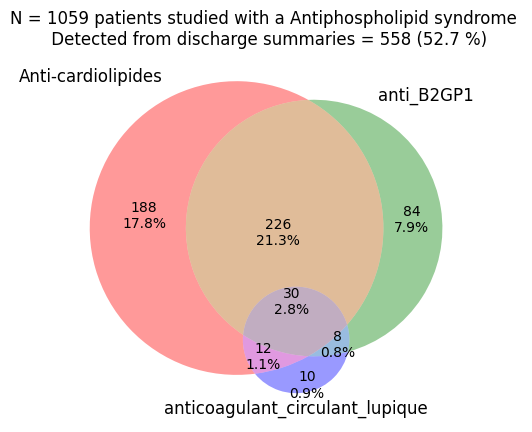

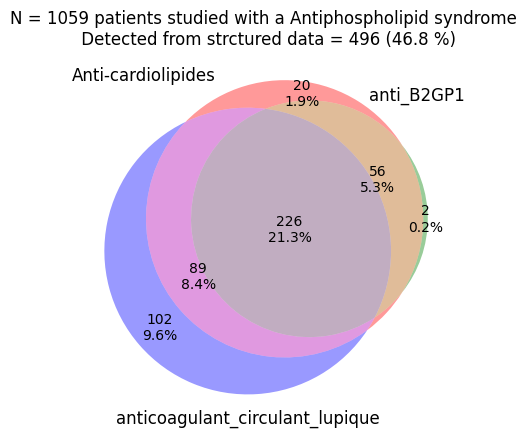

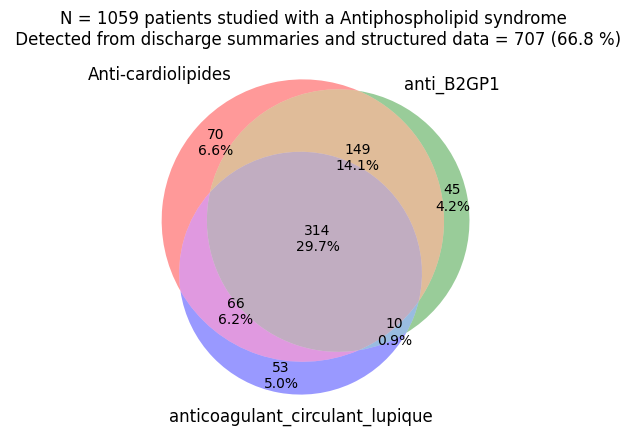

In [57]:
bio_venn = dict(
    A="Anti-cardiolipides", B="anti_B2GP1", C="anticoagulant_circulant_lupique"
)
plot_venn(nlp_patient_group, bio_venn, english_title, method="discharge summaries")
plt.savefig(f"figures/{disease}/venn_nlp.jpeg")
plt.show()
plot_venn(structured_patient_group, bio_venn, english_title, method="strctured data")
plt.savefig(f"figures/{disease}/venn_structured.jpeg")
plt.show()
plot_venn(
    nlp_structured_patient_group,
    bio_venn,
    english_title,
    method="discharge summaries and structured data",
)
plt.savefig(f"figures/{disease}/venn_nlp_structured.jpeg")
plt.show()

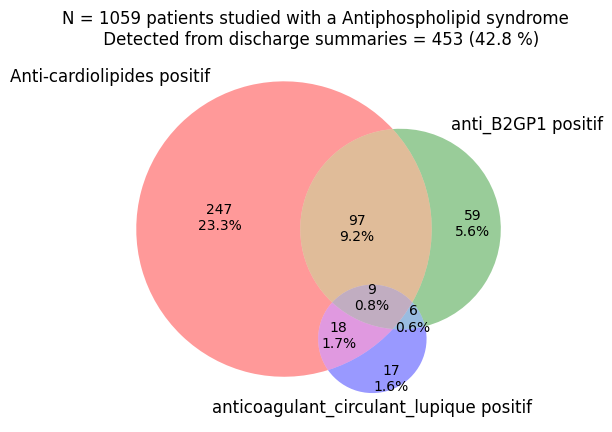

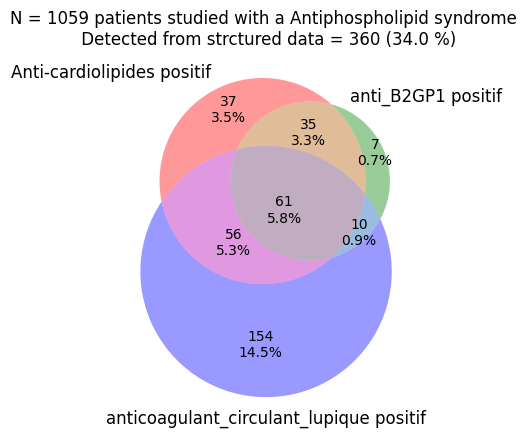

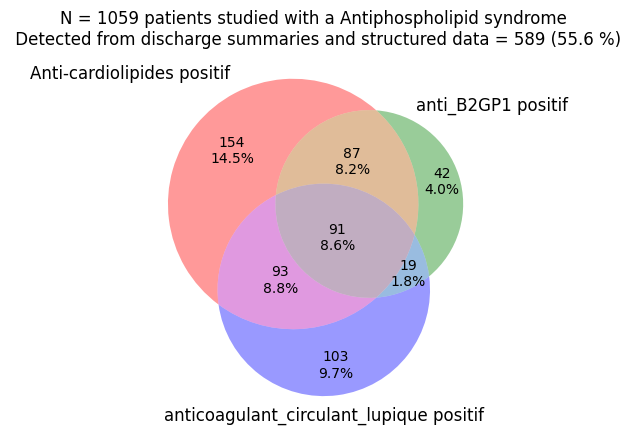

In [58]:
bio_venn = dict(
    A="Anti-cardiolipides positif",
    B="anti_B2GP1 positif",
    C="anticoagulant_circulant_lupique positif",
)
plot_venn(nlp_patient_group, bio_venn, english_title, method="discharge summaries")
plt.savefig(f"figures/{disease}/venn_pos_nlp.jpeg")
plt.show()
plot_venn(structured_patient_group, bio_venn, english_title, method="strctured data")
plt.savefig(f"figures/{disease}/venn_pos_structured.jpeg")
plt.show()
plot_venn(
    nlp_structured_patient_group,
    bio_venn,
    english_title,
    method="discharge summaries and structured data",
)
plt.savefig(f"figures/{disease}/venn_pos_nlp_structured.jpeg")
plt.show()

## Lupus

FAN/AAN (C0587178), Anti-DNA Natif (C1262035)
Anti-Sm (C0201357) 

In [59]:
disease = "lupus_erythemateux_dissemine"
english_title = "Lupus"
nlp_filtered_res, nlp_patient_group = prepare_nlp_df(disease)
structured_filtered_res, structured_patient_group = prepare_structured_df(disease)
structured_filtered_res["method"] = "structured_knowledge"
nlp_filtered_res["method"] = "nlp"
nlp_structured_filtered_res = pd.concat(
    [
        structured_filtered_res[
            ["encounter_num", "patient_num", "value", "unit", "bio", "method"]
        ],
        nlp_filtered_res[
            ["encounter_num", "patient_num", "value", "unit", "bio", "method"]
        ],
    ]
)
nlp_structured_patient_group = (
    pd.concat([nlp_patient_group, structured_patient_group])
    .groupby("patient_num", as_index=False)
    .max()
)

In [60]:
nlp_hists = plot_hist(unit_convert, possible_values, nlp_filtered_res, True).properties(
    title=english_title + " (NLP)"
)
strctured_hists = plot_hist(
    unit_convert, possible_values, structured_filtered_res, False
).properties(title=english_title + " (structured data)")
nlp_strctured_hists = plot_hist(
    unit_convert, possible_values, nlp_structured_filtered_res, False
).properties(title=english_title + " (NLP + structured data)")
chart = (
    (nlp_hists & strctured_hists & nlp_strctured_hists)
    .resolve_scale(x="independent")
    .resolve_scale(y="independent")
    .configure_title(anchor="middle", fontSize=20, orient="left")
)
if not os.path.exists(f"figures/{disease}"):
    os.makedirs(f"figures/{disease}")
chart.save(f"figures/{disease}/histogram.html")
display(chart)

alt.VConcatChart(...)

In [61]:
Biology_nlp_hist.append(
    plot_hist(unit_convert, possible_values, nlp_filtered_res).properties(
        title=english_title + " (NLP)"
    )
)
Biology_structured_hist.append(
    plot_hist(unit_convert, possible_values, structured_filtered_res).properties(
        title=english_title + " (structured data)"
    )
)
Biology_nlp_structured_hist.append(
    plot_hist(unit_convert, possible_values, nlp_structured_filtered_res).properties(
        title=english_title + " (NLP + structured data)"
    )
)

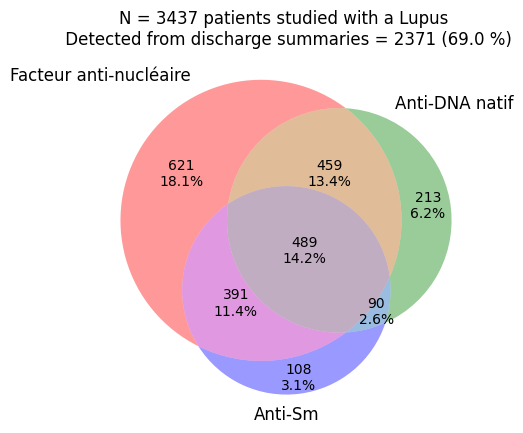

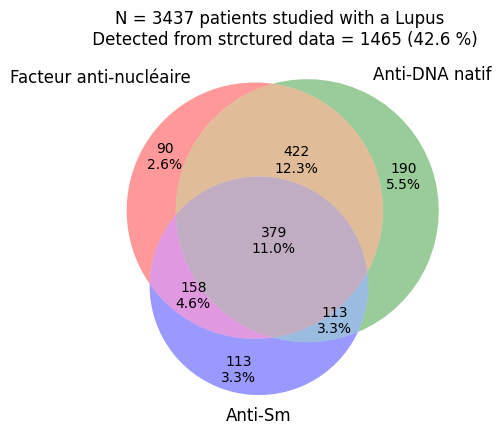

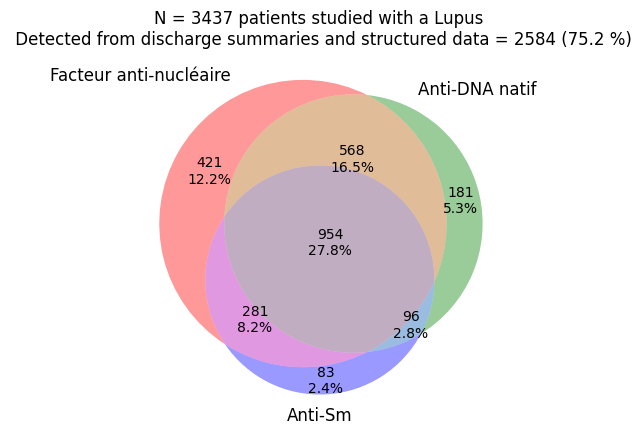

In [62]:
bio_venn = dict(A="Facteur anti-nucléaire", B="Anti-DNA natif", C="Anti-Sm")
plot_venn(nlp_patient_group, bio_venn, english_title, method="discharge summaries")
plt.savefig(f"figures/{disease}/venn_nlp.jpeg")
plt.show()
plot_venn(structured_patient_group, bio_venn, english_title, method="strctured data")
plt.savefig(f"figures/{disease}/venn_structured.jpeg")
plt.show()
plot_venn(
    nlp_structured_patient_group,
    bio_venn,
    english_title,
    method="discharge summaries and structured data",
)
plt.savefig(f"figures/{disease}/venn_nlp_structured.jpeg")
plt.show()

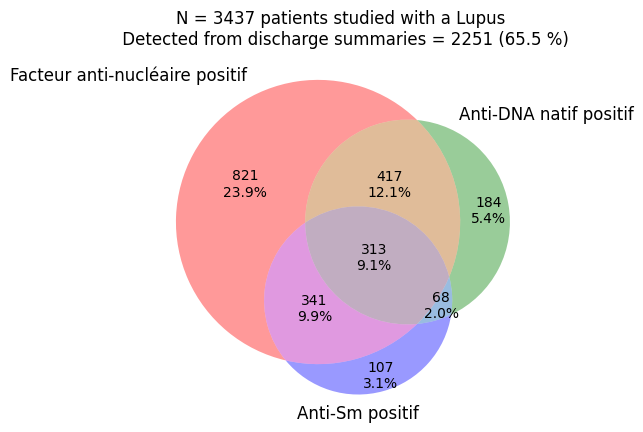

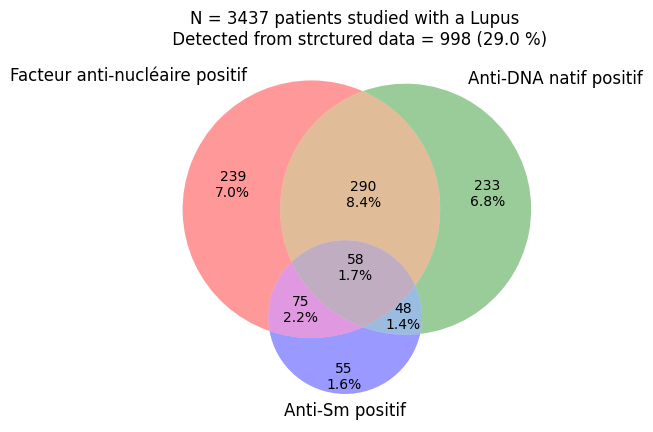

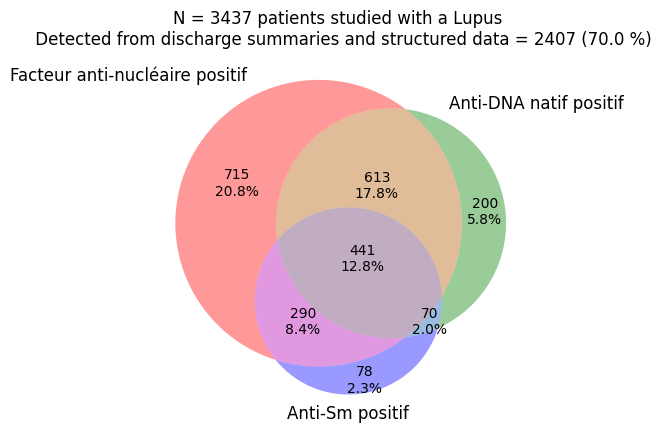

In [63]:
bio_venn = dict(
    A="Facteur anti-nucléaire positif", B="Anti-DNA natif positif", C="Anti-Sm positif"
)
plot_venn(nlp_patient_group, bio_venn, english_title, method="discharge summaries")
plt.savefig(f"figures/{disease}/venn_pos_nlp.jpeg")
plt.show()
plot_venn(structured_patient_group, bio_venn, english_title, method="strctured data")
plt.savefig(f"figures/{disease}/venn_pos_structured.jpeg")
plt.show()
plot_venn(
    nlp_structured_patient_group,
    bio_venn,
    english_title,
    method="discharge summaries and structured data",
)
plt.savefig(f"figures/{disease}/venn_pos_nlp_structured.jpeg")
plt.show()

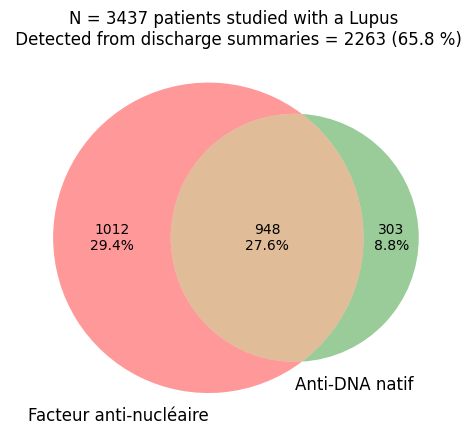

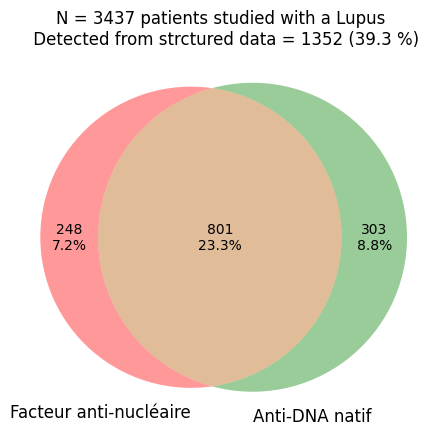

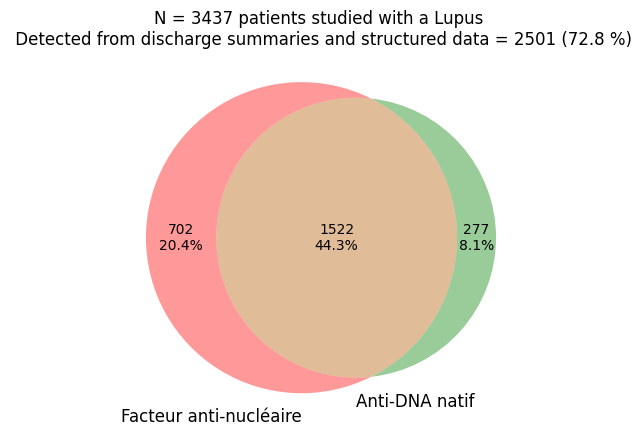

In [65]:
bio_venn = dict(A="Facteur anti-nucléaire", B="Anti-DNA natif")
plot_venn(nlp_patient_group, bio_venn, english_title, method="discharge summaries")
plt.savefig(f"figures/{disease}/venn_2_nlp.jpeg")
plt.show()
plot_venn(structured_patient_group, bio_venn, english_title, method="strctured data")
plt.savefig(f"figures/{disease}/venn_2_structured.jpeg")
plt.show()
plot_venn(
    nlp_structured_patient_group,
    bio_venn,
    english_title,
    method="discharge summaries and structured data",
)
plt.savefig(f"figures/{disease}/venn_2_nlp_structured.jpeg")
plt.show()

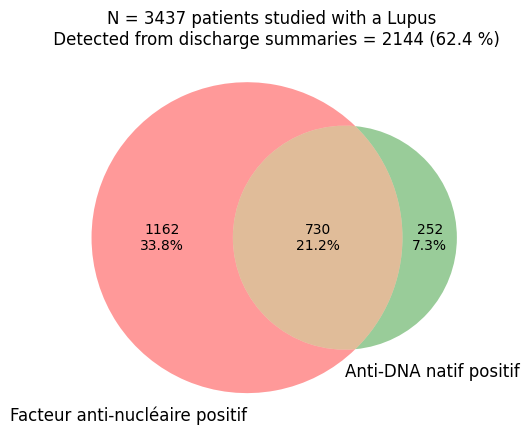

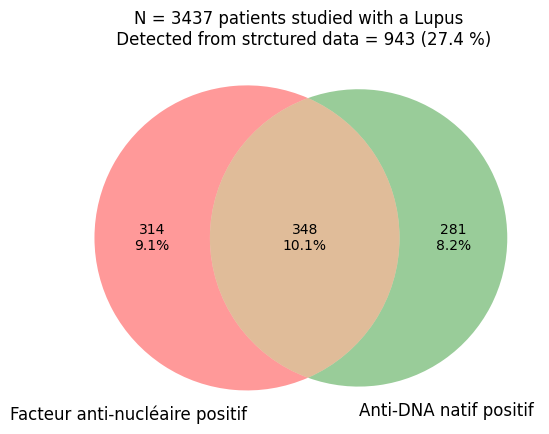

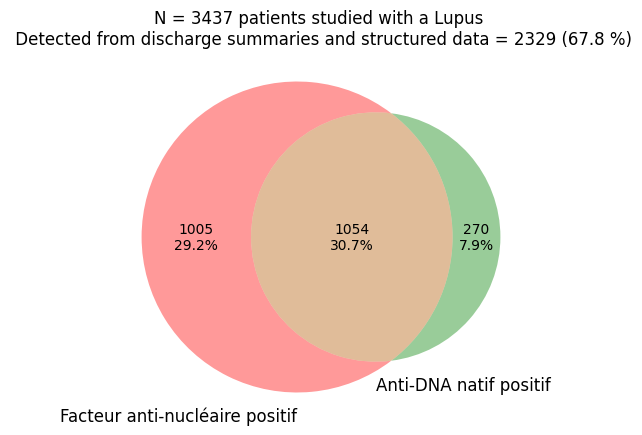

In [66]:
bio_venn = dict(A="Facteur anti-nucléaire positif", B="Anti-DNA natif positif")
plot_venn(nlp_patient_group, bio_venn, english_title, method="discharge summaries")
plt.savefig(f"figures/{disease}/venn_pos_2_nlp.jpeg")
plt.show()
plot_venn(structured_patient_group, bio_venn, english_title, method="strctured data")
plt.savefig(f"figures/{disease}/venn_pos_2_structured.jpeg")
plt.show()
plot_venn(
    nlp_structured_patient_group,
    bio_venn,
    english_title,
    method="discharge summaries and structured data",
)
plt.savefig(f"figures/{disease}/venn_pos_2_nlp_structured.jpeg")
plt.show()

## Sclérodermie systémique

In [67]:
disease = "sclerodermie_systemique"
english_title = "systemic sclerosis"
nlp_filtered_res, nlp_patient_group = prepare_nlp_df(disease)
structured_filtered_res, structured_patient_group = prepare_structured_df(disease)
structured_filtered_res["method"] = "structured_knowledge"
nlp_filtered_res["method"] = "nlp"
nlp_structured_filtered_res = pd.concat(
    [
        structured_filtered_res[
            ["encounter_num", "patient_num", "value", "unit", "bio", "method"]
        ],
        nlp_filtered_res[
            ["encounter_num", "patient_num", "value", "unit", "bio", "method"]
        ],
    ]
)
nlp_structured_patient_group = (
    pd.concat([nlp_patient_group, structured_patient_group])
    .groupby("patient_num", as_index=False)
    .max()
)

In [68]:
nlp_hists = plot_hist(unit_convert, possible_values, nlp_filtered_res, True).properties(
    title=english_title + " (NLP)"
)
strctured_hists = plot_hist(
    unit_convert, possible_values, structured_filtered_res, False
).properties(title=english_title + " (structured data)")
nlp_strctured_hists = plot_hist(
    unit_convert, possible_values, nlp_structured_filtered_res, False
).properties(title=english_title + " (NLP + structured data)")
chart = (
    (nlp_hists & strctured_hists & nlp_strctured_hists)
    .resolve_scale(x="independent")
    .resolve_scale(y="independent")
    .configure_title(anchor="middle", fontSize=20, orient="left")
)
if not os.path.exists(f"figures/{disease}"):
    os.makedirs(f"figures/{disease}")
chart.save(f"figures/{disease}/histogram.html")
display(chart)

alt.VConcatChart(...)

In [69]:
Biology_nlp_hist.append(
    plot_hist(unit_convert, possible_values, nlp_filtered_res).properties(
        title=english_title + " (NLP)"
    )
)
Biology_structured_hist.append(
    plot_hist(unit_convert, possible_values, structured_filtered_res).properties(
        title=english_title + " (structured data)"
    )
)
Biology_nlp_structured_hist.append(
    plot_hist(unit_convert, possible_values, nlp_structured_filtered_res).properties(
        title=english_title + " (NLP + structured data)"
    )
)

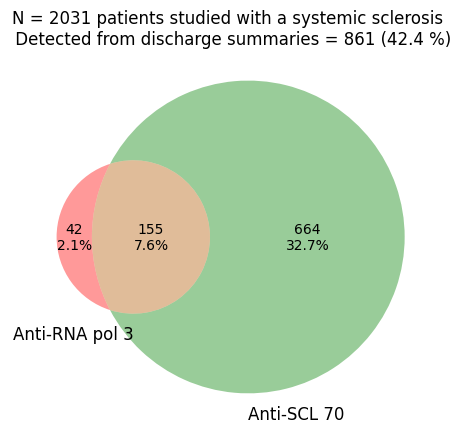

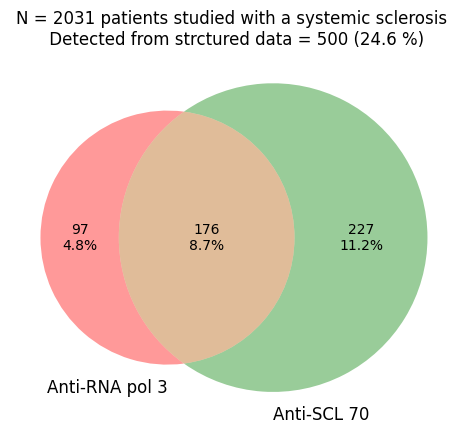

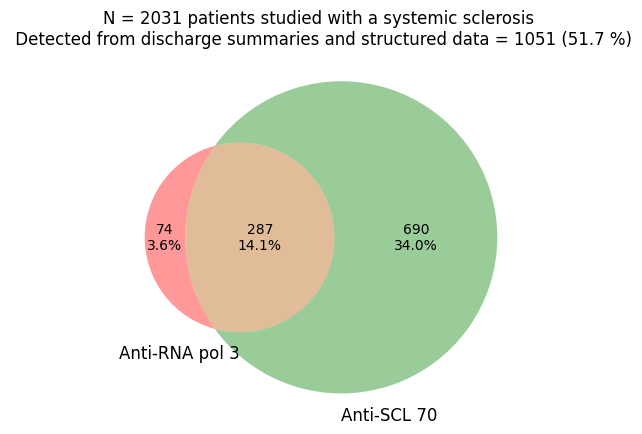

In [70]:
bio_venn = dict(A="Anti-RNA pol 3", B="Anti-SCL 70")
plot_venn(nlp_patient_group, bio_venn, english_title, method="discharge summaries")
plt.savefig(f"figures/{disease}/venn_nlp.jpeg")
plt.show()
plot_venn(structured_patient_group, bio_venn, english_title, method="strctured data")
plt.savefig(f"figures/{disease}/venn_structured.jpeg")
plt.show()
plot_venn(
    nlp_structured_patient_group,
    bio_venn,
    english_title,
    method="discharge summaries and structured data",
)
plt.savefig(f"figures/{disease}/venn_nlp_structured.jpeg")
plt.show()

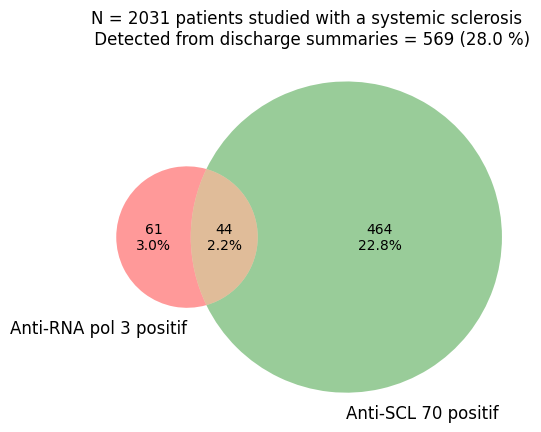

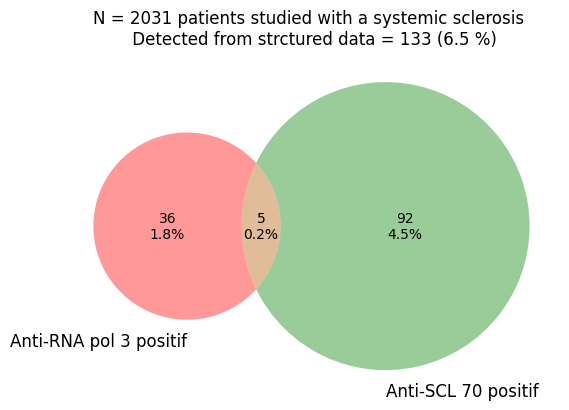

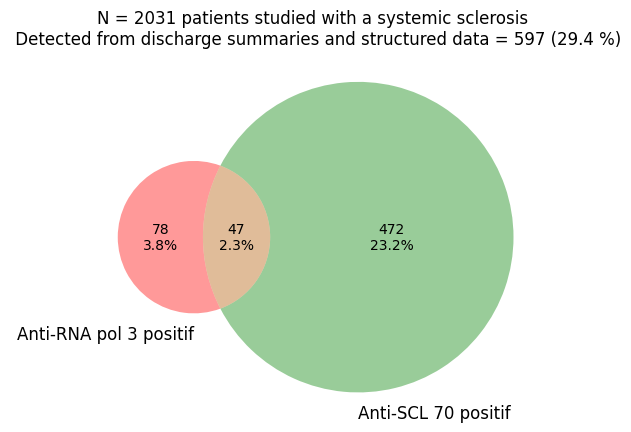

In [71]:
bio_venn = dict(A="Anti-RNA pol 3 positif", B="Anti-SCL 70 positif")
plot_venn(nlp_patient_group, bio_venn, english_title, method="discharge summaries")
plt.savefig(f"figures/{disease}/venn_pos_nlp.jpeg")
plt.show()
plot_venn(structured_patient_group, bio_venn, english_title, method="strctured data")
plt.savefig(f"figures/{disease}/venn_pos_structured.jpeg")
plt.show()
plot_venn(
    nlp_structured_patient_group,
    bio_venn,
    english_title,
    method="discharge summaries and structured data",
)
plt.savefig(f"figures/{disease}/venn_pos_nlp_structured.jpeg")
plt.show()

### Maladie de Takayasu

In [72]:
disease = "maladie_de_takayasu"
english_title = "Takayasu´s disease"
nlp_filtered_res, _ = prepare_nlp_df(disease)
structured_filtered_res, _ = prepare_structured_df(disease)
structured_filtered_res["method"] = "structured_knowledge"
nlp_filtered_res["method"] = "nlp"
nlp_structured_filtered_res = pd.concat(
    [
        structured_filtered_res[
            ["encounter_num", "patient_num", "value", "unit", "bio", "method"]
        ],
        nlp_filtered_res[
            ["encounter_num", "patient_num", "value", "unit", "bio", "method"]
        ],
    ]
)

In [73]:
nlp_hists = plot_hist(unit_convert, possible_values, nlp_filtered_res, True).properties(
    title=english_title + " (NLP)"
)
strctured_hists = plot_hist(
    unit_convert, possible_values, structured_filtered_res, False
).properties(title=english_title + " (structured data)")
nlp_strctured_hists = plot_hist(
    unit_convert, possible_values, nlp_structured_filtered_res, False
).properties(title=english_title + " (NLP + structured data)")
chart = (
    (nlp_hists & strctured_hists & nlp_strctured_hists)
    .resolve_scale(x="independent")
    .resolve_scale(y="independent")
    .configure_title(anchor="middle", fontSize=20, orient="left")
)
if not os.path.exists(f"figures/{disease}"):
    os.makedirs(f"figures/{disease}")
chart.save(f"figures/{disease}/histogram.html")
display(chart)

alt.VConcatChart(...)

In [74]:
Biology_nlp_hist.append(
    plot_hist(unit_convert, possible_values, nlp_filtered_res).properties(
        title=english_title + " (NLP)"
    )
)
Biology_structured_hist.append(
    plot_hist(unit_convert, possible_values, structured_filtered_res).properties(
        title=english_title + " (structured data)"
    )
)
Biology_nlp_structured_hist.append(
    plot_hist(unit_convert, possible_values, nlp_structured_filtered_res).properties(
        title=english_title + " (NLP + structured data)"
    )
)

In [78]:
chart = reduce(
    lambda bar_chart_1, bar_chart_2: (bar_chart_1 & bar_chart_2)
    .resolve_scale(x="independent")
    .resolve_scale(y="independent"),
    Biology_nlp_hist,
).configure_title(orient="left", anchor="middle", fontSize=20)
chart.save("figures/histogram_nlp.html")
display(chart)

alt.VConcatChart(...)

In [79]:
chart = reduce(
    lambda bar_chart_1, bar_chart_2: (bar_chart_1 & bar_chart_2)
    .resolve_scale(x="independent")
    .resolve_scale(y="independent"),
    Biology_structured_hist,
).configure_title(orient="left", anchor="middle", fontSize=20)
chart.save("figures/histogram_structured.html")
display(chart)

alt.VConcatChart(...)

In [80]:
chart = reduce(
    lambda bar_chart_1, bar_chart_2: (bar_chart_1 & bar_chart_2)
    .resolve_scale(x="independent")
    .resolve_scale(y="independent"),
    Biology_nlp_structured_hist,
).configure_title(orient="left", anchor="middle", fontSize=20)
chart.save("figures/histogram_nlp_structured.html")
display(chart)

alt.VConcatChart(...)

In [48]:
res_filtered_df[res_filtered_df.bio == "DFG"].unit.value_counts()

ml_per_min    77
nounit         1
mmol_per_l     1
Name: unit, dtype: int64

In [ ]:
"Anti-B2GP1" =[
    "E9627",
    "A7854",
    "H3772",
    "E5157",
    "I2042",
    "I1882",
    "X9708",
    "H6269",
    "X5898",
    "X2761",
    "A7855",
    "H9650",
    "E9626",
    "I2043",
    "I1883",
    "X9707",
    "H6270",
    "X5899",
    "I5970",
    "H5543",
    "H6271",
    "J9678",
    "J9704",
    "J9705",
    "K8345",
]

In [70]:
structured_filtered_res.explode("name_char").name_char.str.split(":").str.get(0).unique()

array([nan, 'A0163 ', 'A0094 ', 'A0091 ', 'A0248 ', 'A7813 ', 'X5174 ',
       'A0092 ', 'B2320 ', 'C8222 ', 'E4733 ', 'E4732 ', 'E4731 ',
       'C8745 ', 'A0985 ', 'A3994 ', 'G1974 ', 'G1975 ', 'A1269 ',
       'A3822 ', 'E6357 ', 'F6068 ', 'A9876 ', 'A0984 ', 'E4730 ',
       'F9618 ', 'A9873 ', 'A9881 ', 'A9880 ', 'A0986 ', 'C0694 ',
       'C4781 '], dtype=object)

In [216]:
structured_res = pd.read_json(
    join(BRAT_DIR, "summary_df_bio.json"),
    dtype={"encounter_num": str, "patient_num": str},
).explode("label")

In [220]:
structured_res = structured_res.explode("name_char")
structured_res[structured_res.name_char.str.contains("F8160")]

,disease,terms_linked_to_measurement,name_char,gold,label,des,encounter_num,patient_num
9,lupus_erythemateux_dissemine,Débit filtration glomérulaire Créatinine,F8160 : Débit filtration glomérulaire Créatini...,"[90.0 mL/min/1,73m²]",C0373595,Creatinine clearance glom filt,-1003096193368992544,7706753715636037721
9,lupus_erythemateux_dissemine,Débit filtration glomérulaire Créatinine,F8160 : Débit filtration glomérulaire Créatini...,"[90.0 mL/min/1,73m²]",C1540962,Creatinine clearance glom filt,-1003096193368992544,7706753715636037721
189,lupus_erythemateux_dissemine,Débit filtration glomérulaire Créatinine,F8160 : Débit filtration glomérulaire Créatini...,"[102.4 mL/min/1,73m², 112.1 mL/min/1,73m², 115...",C0373595,Creatinine clearance glom filt,-1007981841955736956,8504471614187815299
189,lupus_erythemateux_dissemine,Débit filtration glomérulaire Créatinine,F8160 : Débit filtration glomérulaire Créatini...,"[102.4 mL/min/1,73m², 112.1 mL/min/1,73m², 115...",C0373595,Creatinine clearance glom filt,-1007981841955736956,8504471614187815299
189,lupus_erythemateux_dissemine,Débit filtration glomérulaire Créatinine,F8160 : Débit filtration glomérulaire Créatini...,"[102.4 mL/min/1,73m², 112.1 mL/min/1,73m², 115...",C0373595,Creatinine clearance glom filt,-1007981841955736956,8504471614187815299
...,...,...,...,...,...,...,...,...
893939,syndrome_des_anti-phospholipides,Débit filtration glomérulaire Créatinine,F8160 : Débit filtration glomérulaire Créatini...,"[90.0 mL/min/1,73m², 90.0 mL/min/1,73m², 90.0 ...",C1540962,Creatinine clearance glom filt,9178146602871215887,-3679678861486144930
894006,syndrome_des_anti-phospholipides,Débit filtration glomérulaire Créatinine,F8160 : Débit filtration glomérulaire Créatini...,"[9.3 mL/min/1,73m², 9.8 mL/min/1,73m²]",C0373595,Creatinine clearance glom filt,9181591999872733553,-8540849045465326606
894006,syndrome_des_anti-phospholipides,Débit filtration glomérulaire Créatinine,F8160 : Débit filtration glomérulaire Créatini...,"[9.3 mL/min/1,73m², 9.8 mL/min/1,73m²]",C0373595,Creatinine clearance glom filt,9181591999872733553,-8540849045465326606
894006,syndrome_des_anti-phospholipides,Débit filtration glomérulaire Créatinine,F8160 : Débit filtration glomérulaire Créatini...,"[9.3 mL/min/1,73m², 9.8 mL/min/1,73m²]",C1540962,Creatinine clearance glom filt,9181591999872733553,-8540849045465326606
